<a href="https://colab.research.google.com/github/gilbert-umuzi/covid-19/blob/main/COVID_19_Feature_Exploration_Analysis_with_CUSP.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

SPDX-License-Identifier: Apache-2.0

**Author**: Gilbert Pooley


# Welcome!

Welcome to this Colab notebook!

First, a big thanks to Yi Gao, Xianzhi Helen Wang, the authors of [COVID-19 Feature Exploration Analysis with Data Commons](https://colab.research.google.com/github/datacommonsorg/api-python/blob/master/notebooks/COVID_19_Feature_Exploration_Analysis_with_Data_Commons.ipynb). Their interesting analysis of covid cases and deaths at a US county level inspired this update.


**What's in this update?**

1. **A longer analysis period**: The original analysis was done in July 2020 covering the period 2020-02-26 to 2020-07-10. This update extends the analysis until 2022-05-13 based on the covid case and mortality data from [nytimes covid-19 data set](https://github.com/nytimes/covid-19-data/blob/master/README.md).

2. **States policy responses**: The impact of states different policy responses based on 'CUSP': [COVID-19-US-State-Policy-Database](https://github.com/USCOVIDpolicy/COVID-19-US-State-Policy-Database).

  *CUSP is the most comprehensive publicly available policy database of health, social, and economic policies in response to the COVID-19 pandemic in the US. CUSP documents widespread variation in state policy decisions and implementation dates across the US and serves as a freely available and valuable resource to policymakers and researchers.*


Like the original analysis, I ask the questions:

1. How do the COVID-19 case trends differ across different counties?
2. What features are potentially correlated with COVID-19 mortality rate?

To these questions I add:

3. Did the states' different policy responses have a significant impact on county case and mortality rates?

**Some notes on the data used in this notebook:**

* This is a work in progress. There are next steps listed at the end. The most pressing is explaining the (unreported) pseudo-r2 of 1.0 in the original logit model. This limits the interprability of the logit regression analysis.

While I update the covid case and mortality data, for consistency I use the same context data as the original study.

* The analysis period begins on 2020-02-26. The start date is chosen since it's the time of the first instance of community spread as reported [here](https://www.cdc.gov/media/releases/2020/s0226-COVID-19-spread.html).
* The analysis period ends on 2022-05-13, which is the last observation in the [nytimes covid-19 data set](https://github.com/nytimes/covid-19-data/blob/master/README.md).
* For context data, they are the values at the time when this data set was initially generated (2020-07-15) by Yi Gao, Xianzhi Helen Wang. More details about the context features' definition can be found on Data Commons ([link](http://docs.datacommons.org/statistical_variables.html)).

Although Yi Gao, Xianzhi Helen Wang said one could find live versions of the data sets via the Data Commons API, gremlins prevented me from using the API to update the case and mortality data, so I went to the original source, nytimes. My API issue may have been due to a Data Commons update of covid DCIDs since this original notebook was published.

Hope you enjoy the exploratory analysis here! Please contact me with feedback or questions at gilbert [dot] pooley [at] gmail [dot] com

## Load Packages

In [ ]:
#!pip install -U plotly

import json
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import plotly.express as px
import random
import seaborn as sns
import statsmodels.api as sm
import pickle
from google.colab import files

from collections import defaultdict
from datetime import datetime
from sklearn.preprocessing import MinMaxScaler
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import silhouette_score
from urllib.request import urlopen

# For map plots.
counties_geo_path = 'https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json'
with urlopen(counties_geo_path) as response:
    COUNTIES_GEO = json.load(response)

pd.set_option('max_colwidth', 400)


# Prepare

## Load and join data sets

In [ ]:
# Set date range for analysis
analysis_data_start = datetime.strptime('2020-02-26', '%Y-%m-%d')
analysis_data_end = datetime.strptime('2022-05-13', '%Y-%m-%d')
date_range =  pd.date_range(analysis_data_start, analysis_data_end).format(
    formatter=lambda x: x.strftime('%Y-%m-%d'))
count_data_columns = ['County', 'Name'] + date_range

# Load original covariate data
STATE_COVARIATE_PATH = 'https://docs.google.com/spreadsheets/d/e/2PACX-1vR12v_MRKdDa6u2mdD0aPFlDilV0SJtbeYyrNbqI3qZDuImw_RnDcpNAmwbJkRP7O7fAC-9EYsoV4Dm/pub?output=csv'
df_state_context = pd.read_csv(STATE_COVARIATE_PATH)
COUNTY_COVARIATE_PATH = 'https://docs.google.com/spreadsheets/d/e/2PACX-1vSSeYEVT9wH-F6X7qxnhyXke1JoudkpqAJqVdZWlkTLF0Ah5529VDB4gLLICrqpczbvl-qi_P7Eyte7/pub?output=csv'
df_county_context = pd.read_csv(COUNTY_COVARIATE_PATH)

In [ ]:
# Create geoid - county / state name mapping.
df_county_name = df_county_context[['County', 'Name']].copy()
df_county_name['State'] = df_county_name['County'].apply(lambda x: x[:-3])
df_county_name = pd.merge(df_county_name, df_state_context[['State', 'Name']],
                          on='State', suffixes=('_county', '_state'))
df_county_name['full_name'] = df_county_name['Name_county'] + ', '+ \
  df_county_name['Name_state']

county_name_mapping = defaultdict(str)
for _, row in df_county_name.iterrows():
  county_name_mapping[row['County']] = row['full_name']

def get_name_by_geoid(geoid):
  return county_name_mapping[geoid]

In [ ]:
# NEW DATA from nytimes: https://github.com/nytimes/covid-19-data/blob/master/README.md
url = 'https://raw.githubusercontent.com/nytimes/covid-19-data/62ef34cfcb60214be873a38d73619da9ea57d50b/us-counties.csv'
nyt_counties = pd.read_csv(url)

# Pivot the data to transform dates into columns
df_county_case_nyt = nyt_counties.pivot_table(index=['fips','county'], columns='date', values='cases', fill_value=0)
df_county_death_nyt = nyt_counties.pivot_table(index=['fips','county'], columns='date', values='deaths', fill_value=0)

# Reset index to make 'county' a regular column
df_county_case_nyt.reset_index(inplace=True)
df_county_death_nyt.reset_index(inplace=True)

# Rename 'county' column to 'Name'
df_county_case_nyt.rename(columns={'county': 'Name'}, inplace=True)
df_county_death_nyt.rename(columns={'county': 'Name'}, inplace=True)

# Update 'Name' column
df_county_case_nyt['Name'] = df_county_case_nyt['Name'].apply(lambda x: x + ' County')
df_county_death_nyt['Name'] = df_county_death_nyt['Name'].apply(lambda x: x + ' County')

# Function to convert fips to DCID format
def fips_to_dcid(fips):
    return 'geoId/{:05d}'.format(int(fips)) if pd.notna(fips) else None

# Apply the function to the 'fips' column
df_county_case_nyt['DCID'] = df_county_case_nyt['fips'].apply(fips_to_dcid)
df_county_death_nyt['DCID'] = df_county_death_nyt['fips'].apply(fips_to_dcid)

# Merge with df_county_name
df_county_case_nyt = df_county_case_nyt.merge(df_county_name[['County', 'Name_county']], left_on='DCID', right_on='County')
df_county_death_nyt = df_county_death_nyt.merge(df_county_name[['County', 'Name_county']], left_on='DCID', right_on='County')

# Reorder columns
front_columns = ['fips','Name','DCID','County','Name_county']
df_county_case_nyt = df_county_case_nyt[front_columns + [col for col in df_county_case_nyt.columns if col not in front_columns]]
df_county_death_nyt = df_county_death_nyt[front_columns + [col for col in df_county_death_nyt.columns if col not in front_columns]]


In [ ]:
# Drop unnecessary columns
df_county_case = df_county_case_nyt.drop(['fips', 'DCID','Name_county'],axis=1)
df_county_death = df_county_death_nyt.drop(['fips', 'DCID','Name_county'],axis=1)

In [ ]:
df_county_case.head()

,Name,County,2020-01-21,2020-01-22,2020-01-23,2020-01-24,2020-01-25,2020-01-26,2020-01-27,2020-01-28,...,2022-05-04,2022-05-05,2022-05-06,2022-05-07,2022-05-08,2022-05-09,2022-05-10,2022-05-11,2022-05-12,2022-05-13
0,Autauga County,geoId/01001,0,0,0,0,0,0,0,0,...,15839,15840,15840,15840,15840,15846,15852,15853,15860,15863
1,Baldwin County,geoId/01003,0,0,0,0,0,0,0,0,...,55695,55713,55730,55730,55730,55761,55792,55807,55831,55862
2,Barbour County,geoId/01005,0,0,0,0,0,0,0,0,...,5671,5671,5672,5672,5672,5675,5677,5677,5678,5681
3,Bibb County,geoId/01007,0,0,0,0,0,0,0,0,...,6443,6444,6444,6444,6444,6447,6450,6453,6455,6457
4,Blount County,geoId/01009,0,0,0,0,0,0,0,0,...,14983,14985,14985,14985,14985,14988,14994,14999,15004,15005


In [ ]:
df_county_death.head()

,Name,County,2020-01-21,2020-01-22,2020-01-23,2020-01-24,2020-01-25,2020-01-26,2020-01-27,2020-01-28,...,2022-05-04,2022-05-05,2022-05-06,2022-05-07,2022-05-08,2022-05-09,2022-05-10,2022-05-11,2022-05-12,2022-05-13
0,Autauga County,geoId/01001,0,0,0,0,0,0,0,0,...,216,216,216,216,216,216,216,216,216,216
1,Baldwin County,geoId/01003,0,0,0,0,0,0,0,0,...,680,680,680,680,680,680,680,680,680,681
2,Barbour County,geoId/01005,0,0,0,0,0,0,0,0,...,98,98,98,98,98,98,98,98,98,98
3,Bibb County,geoId/01007,0,0,0,0,0,0,0,0,...,104,104,104,104,104,104,104,104,105,105
4,Blount County,geoId/01009,0,0,0,0,0,0,0,0,...,243,243,243,243,243,243,243,243,243,243


In [ ]:
# Merge the county level DataFrames
df_county_joined = pd.merge(df_county_case, df_county_death, how='outer',
                            suffixes=('_case', '_death'),
                            on=['County', 'Name']).pipe(
                                pd.merge,right=df_county_context, how='outer')
df_county_joined = df_county_joined.set_index('County')
df_county_joined = df_county_joined.join(df_county_name)

case_columns = [date + '_case' for date in date_range]
death_columns = [date + '_death' for date in date_range]

In [ ]:
# Check the shapes of the loaded DataFrames
print(f'The shape of df_state_context is {df_state_context.shape}.')
print(f'The shape of df_county_context is {df_county_context.shape}.')
print(f'The shape of df_county_case is {df_county_case.shape}.')
print(f'The shape of df_county_death is {df_county_death.shape}.')
print(f'The shape of df_county_joined is {df_county_joined.shape}.')

The shape of df_state_context is (52, 192).
The shape of df_county_context is (3190, 182).
The shape of df_county_case is (3177, 846).
The shape of df_county_death is (3099, 846).
The shape of df_county_joined is (3418, 1874).


# CUSP data

In [ ]:
# Fetch data from CUSP on Github
url = 'https://raw.githubusercontent.com/USCOVIDpolicy/COVID-19-US-State-Policy-Database/ec727582ef4e4029d0a97126dd23f0e7518a8cd3/COVID-19%20US%20state%20policy%20database%203_30_2022.xlsx'
cusp_metadata = pd.read_excel(url, header=None, nrows=5)
cusp = pd.read_excel(url, skiprows=4)

# Set new column names to cusp DataFrame
new_column_names = cusp_metadata.iloc[0]  # Select the first row for column names
cusp.columns = new_column_names
cusp_metadata.columns = new_column_names
cusp_metadata = cusp_metadata.drop(0,axis = 0)
cusp_metadata = cusp_metadata.reset_index(drop=True)

display(cusp_metadata.head())
display(cusp.head())


,STATE,POSTCODE,FIPS,STEMERG,STEMERGEND,STEMERG2,CLSCHOOL,CLDAYCR,OPNCLDCR,CLNURSHM,...,MINWAGEMAR2019,MINWAGEJUL2019,MINWAGEOCT2019,MINWAGEJAN2020,MINWAGEJUL2020,MINWAGESEP2020,MINWAGEOCT2020,TIPMINWAGE2020,MINWAGE2021,SMALLBUSMINWAGE
0,State,State Abbreviation,FIPS Code,State of emergency issued,State of emergency lifted,State of emergency reinstated,Date closed K-12 public schools,Closed day cares,Reopen day cares,Date banned visitors to nursing homes,...,Mar 29 2019 Minimum Wage,Jul 1 2019 Minimum Wage,Oct 1 2019 Minimum Wage,Jan 1 2020 Minimum Wage,Jul 1 2020 Minimum Wage,Sep 1 2020 Minimum Wage,Oct 1 2020 Minimum Wage,2020 Minimum Wage for Tipped Workers,2021 Minimum Wage,Different Minimum Wage for Smaller Businesses
1,category,NaN,NaN,state_of_emergency,state_of_emergency,state_of_emergency,physical_distance_closure,physical_distance_closure,Reopening,physical_distance_closure,...,minimum_wage,minimum_wage,minimum_wage,minimum_wage,minimum_wage,minimum_wage,minimum_wage,minimum_wage,minimum_wage,minimum_wage
2,type,note,note,start,end,start,start,start,end,start,...,quantity,quantity,quantity,quantity,quantity,quantity,quantity,quantity,quantity,attribute
3,unit,text,attribute,date,date,date,date,date,date,date,...,dollars,dollars,dollars,dollars,dollars,dollars,dollars,dollars,dollars,flag


,STATE,POSTCODE,FIPS,STEMERG,STEMERGEND,STEMERG2,CLSCHOOL,CLDAYCR,OPNCLDCR,CLNURSHM,...,MINWAGEMAR2019,MINWAGEJUL2019,MINWAGEOCT2019,MINWAGEJAN2020,MINWAGEJUL2020,MINWAGESEP2020,MINWAGEOCT2020,TIPMINWAGE2020,MINWAGE2021,SMALLBUSMINWAGE
0,Alabama,AL,1,2020-03-13,2021-07-06 00:00:00,2021-08-13 00:00:00,2020-03-20 00:00:00,2020-03-20 00:00:00,2020-05-23 00:00:00,2020-03-19 00:00:00,...,7.25,7.25,7.25,7.25,7.25,7.25,7.25,2.13,7.25,0
1,Alaska,AK,2,2020-03-11,2021-04-30 00:00:00,0,2020-03-16 00:00:00,0,0,0,...,9.89,9.89,9.89,10.19,10.19,10.19,10.19,10.19,10.34,0
2,Arizona,AZ,4,2020-03-11,0,0,2020-03-16 00:00:00,0,0,0,...,11.00,11.00,11.00,12.00,12.00,12.00,12.00,9.00,12.15,0
3,Arkansas,AR,5,2020-03-11,2021-05-30 00:00:00,2021-07-29 00:00:00,2020-03-17 00:00:00,0,0,2020-03-13 00:00:00,...,9.25,9.25,9.25,10.00,10.00,10.00,10.00,2.63,11.00,1
4,California,CA,6,2020-03-04,0,0,2020-03-23 00:00:00,0,0,0,...,12.00,12.00,12.00,13.00,13.00,13.00,13.00,13.00,14.00,1


In [ ]:
# Transforming cusp variables

# Edits to cusp_metadata
cusp_metadata.loc[3, 'LMABRN'] = 'flag'
cusp_metadata.loc[3, 'CURFEW'] = 'date'
cusp_metadata.loc[3, 'VISITRES2'] = 'date'
cusp_metadata.loc[2, 'VBMGENELEC'] = 'start'
cusp_metadata.loc[3, 'VBMGENELEC'] = 'date'

# Setup new dataframe
cusp_variables = pd.DataFrame(index=cusp.index)
cusp_variables['STATE'] = cusp['STATE']

# Function to handle type = date
''' Handles start and end dates separately, converting them to durations based on analysis_end_date
'''
def transform_date(event_date, analysis_data_end):
    # Check if event_date is 0
    if event_date == 0:
        return 0
    else:
        # Convert event_date to datetime
        event_date = pd.to_datetime(event_date, errors='coerce')

        # Check if conversion is successful (not NaT)
        if pd.isna(event_date):
            return None  # Or return a default value as per your requirement

        # Check if difference in days is negative
        if (analysis_data_end - event_date).days < 0:
            return 0

        # Calculate difference in days
        return (analysis_data_end - event_date).days

def transform_text(value):
    # Define a mapping from the text/number values to a numerical scale
    value_mapping = {'1': 1, '1A': 1, '1B': 2, '1C': 3, '1D': 4, '1E': 5,
                     '2': 6, '2A': 6, '2B': 7,
                     '3': 8, '3A': 8, '3B': 9,
                     '4': 10,
                     '5': 11}

    # Convert integer values to string
    if isinstance(value, int):
        value = str(value)

    # Return the corresponding numerical value
    return value_mapping.get(value, None)  # Returns None if value is not in the mapping

def transform_dollars(value):
    # Handle specific case
    if isinstance(value, str) and 'Max Benefit < $' in value:
        value = value.replace('Max Benefit < $', '')

    # Remove dollar sign if present
    value = value.replace('$', '') if isinstance(value, str) else value

    # Convert to float
    try:
        return float(value)
    except ValueError:
        return None  # or some default value

def transform_flag(value):
    # If the value contains a '.', set to 0
    if isinstance(value, str) and '.' in value:
        return 0
    else:
        # Otherwise, leave the value as is
        return value

def transform_days(value):
    # If the value contains a '.', set to 0
    if isinstance(value, str) and '.' in value:
        return 0
    else:
        # Otherwise, leave the value as is
        return value

def transform_rate(value):
    # If the value contains a '-', set to 0
    if isinstance(value, str) and '-' in value:
        return 0
    else:
        # Otherwise, leave the value as is
        return value

def transform_percent(value):
    # If the value contains a '-', set to 0
    if isinstance(value, str) and '-' in value:
        return 0
    else:
        # Otherwise, leave the value as is
        return value

# Ensure analysis_data_end is defined with the appropriate date
analysis_data_end = pd.to_datetime(analysis_data_end)

# Temporary dictionary to store new columns
new_columns = {}

# Loop through each column in cusp
for col in cusp.columns[3:]:
    # Get the data type from cusp_metadata, assuming it's in the 4th row
    data_type = cusp_metadata.loc[3, col]

    # Apply transformation based on data type
    if data_type == 'date':
        new_columns[col + '_duration'] = cusp[col].apply(lambda x: transform_date(x, analysis_data_end))
    elif data_type == 'text':
        new_columns[col + '_scale'] = cusp[col].apply(lambda x: transform_text(x))
    elif data_type == 'dollars':
        new_columns[col + '_dollars'] = cusp[col].apply(lambda x: transform_dollars(x))
    elif data_type == 'flag':
        new_columns[col + '_flag'] = cusp[col].apply(lambda x: transform_flag(x))
    elif data_type == 'days':
        new_columns[col + '_days'] = cusp[col].apply(lambda x: transform_days(x))
    elif data_type == 'rate':
        new_columns[col + '_rate'] = cusp[col].apply(lambda x: transform_rate(x))
    elif data_type == 'percent':
        new_columns[col + '_percent'] = cusp[col].apply(lambda x: transform_percent(x))
    else:
        new_columns[col] = cusp[col]

# Concatenate new columns to cusp_variables
cusp_variables = pd.concat([cusp_variables, pd.DataFrame(new_columns, index=cusp.index)], axis=1)

In [ ]:
# Normalizing and standardizing

# Initialize the MinMaxScaler
scaler = MinMaxScaler()

# Filter out columns that do not end with '_flag' and also exclude the 'STATE' column
columns_to_scale = [col for col in cusp_variables.columns if not col.endswith('_flag') and col != 'STATE']

# Apply the MinMaxScaler to these columns
cusp_variables[columns_to_scale] = scaler.fit_transform(cusp_variables[columns_to_scale])

# Check the scaled data
cusp_variables.head()

,STATE,STEMERG_duration,STEMERGEND_duration,STEMERG2_duration,CLSCHOOL_duration,CLDAYCR_duration,OPNCLDCR_duration,CLNURSHM_duration,STAYHOME_duration,STAYHOMENOGP_duration,...,MINWAGEMAR2019_dollars,MINWAGEJUL2019_dollars,MINWAGEOCT2019_dollars,MINWAGEJAN2020_dollars,MINWAGEJUL2020_dollars,MINWAGESEP2020_dollars,MINWAGEOCT2020_dollars,TIPMINWAGE2020_dollars,MINWAGE2021_dollars,SMALLBUSMINWAGE_flag
0,Alabama,0.1875,0.528912,0.947917,0.994924,0.994924,0.969044,0.987421,0.979618,0.0,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0
1,Alaska,0.3125,0.642857,0.000000,1.000000,0.000000,0.000000,0.000000,0.988535,0.0,...,0.440000,0.391111,0.391111,0.435556,0.379355,0.379355,0.379355,0.708883,0.398710,0
2,Arizona,0.3125,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.984713,0.0,...,0.625000,0.555556,0.555556,0.703704,0.612903,0.612903,0.612903,0.604222,0.632258,0
3,Arkansas,0.3125,0.591837,1.000000,0.998731,0.000000,0.000000,0.994969,0.000000,0.0,...,0.333333,0.296296,0.296296,0.407407,0.354839,0.354839,0.354839,0.043975,0.483871,1
4,California,0.7500,0.000000,0.000000,0.991117,0.000000,0.000000,0.000000,1.000000,0.0,...,0.791667,0.703704,0.703704,0.851852,0.741935,0.741935,0.741935,0.956025,0.870968,1


In [ ]:
# Merge cusp_variables with df_county_name to get 'State' IDs matched with 'STATE'
cusp_variables = cusp_variables.merge(df_county_name[['State', 'Name_state']],
                                      left_on='STATE',
                                      right_on='Name_state',
                                      how='left')

cusp_variables.rename(columns={'State': 'STATE_ID'}, inplace=True)
cusp_variables.drop(columns='Name_state', inplace=True)
columns = list(cusp_variables.columns)
columns.remove('STATE')
columns.remove('STATE_ID')
new_order = ['STATE', 'STATE_ID'] + columns
cusp_variables = cusp_variables.reindex(columns=new_order)

cusp_variables.head()

,STATE,STATE_ID,STEMERG_duration,STEMERGEND_duration,STEMERG2_duration,CLSCHOOL_duration,CLDAYCR_duration,OPNCLDCR_duration,CLNURSHM_duration,STAYHOME_duration,...,MINWAGEMAR2019_dollars,MINWAGEJUL2019_dollars,MINWAGEOCT2019_dollars,MINWAGEJAN2020_dollars,MINWAGEJUL2020_dollars,MINWAGESEP2020_dollars,MINWAGEOCT2020_dollars,TIPMINWAGE2020_dollars,MINWAGE2021_dollars,SMALLBUSMINWAGE_flag
0,Alabama,geoId/01,0.1875,0.528912,0.947917,0.994924,0.994924,0.969044,0.987421,0.979618,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
1,Alabama,geoId/01,0.1875,0.528912,0.947917,0.994924,0.994924,0.969044,0.987421,0.979618,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
2,Alabama,geoId/01,0.1875,0.528912,0.947917,0.994924,0.994924,0.969044,0.987421,0.979618,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
3,Alabama,geoId/01,0.1875,0.528912,0.947917,0.994924,0.994924,0.969044,0.987421,0.979618,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
4,Alabama,geoId/01,0.1875,0.528912,0.947917,0.994924,0.994924,0.969044,0.987421,0.979618,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0


# How do COVID-19 cases trends differ across different counties?

Following the original analysis, we consider different case trends across counties.

"Here are the main steps in this example:
1. Calculate normalized case trends.
2. Cluster the counties of similar case growth patterns.
3. Visualize the main trend of each cluster.
4. Visualize the clustering result on the U.S. map.



## Calculate normalized trends

The positive case counts available in DataCommons are cumulative counts. In this part, we calculate daily incremental case counts and normalize them by population, so that trends can be compared between different counties.

**Technical detail**

We will cluster the counties by their smoothed trends of incremental positive cases normalized by population:

$$\frac{\#\ of\ incremental\ positive\ cases}{county\ population}.$$

The $\#\ of\ incremental\ positive\ cases$ is the number of new cases diagnosed with COVID-19 on each day in each county. We want to look at incremental changes instead of the cumulative trends because it's easier to distinguish / interpret incremental change patterns (which can go up / down) compared to cumulative trend patterns (which all go up).

The incremental cases are normalized by population as we expect to see higher case numbers in counties with more people. Simply clustering the counties using the incremental case numbers will possibly generate clusters just reflecting county populations. After the normalization, we can have the numbers that are roughly comparable among the counties, regardless of their population, so that the clustering results can better reflect the severity of the counties.

In addition, the trends are smoothed with centered 7-day moving average to adjust for weekday effects.

We will see what are the main trend patterns during the analysis period and how they are distributed in the U.S."

In [ ]:
def obtain_incremental_trend(df, count_columns, smooth=True, clip=True):
  """Obtains the normalized incremental changes.

     The input df contains cumulative counts of interest, and this function
     calculates normalized incremental changes from that df.

  Args:
    df: A data frame with joined data.
    count_columns: Columns in the joined data dataframe specifying the columns
      of cumulative counts. They should have the format YYYY-MM-DD_[case|death].
    smooth: Whether to take rolling averages of the counts. If True, the output
      will be 7-day centered rolling averages of incremental changes in each
      county. Otherwise the raw incremental trends will be returned. Note that
      first 3 days and last 3 days will be removed if smooth=True.
    clip: Whether to replace negative incremental changes as 0.

  Returns:
    A dataframe with dates as index and county geoId as columns names. Each
    column is a series of incremental changes in the county.
  """
  trends = df[count_columns].apply(lambda x: x / df['Count_Person'])
  trends = trends.transpose()
  trends.index = pd.to_datetime([idx.split('_')[0] for idx in trends.index])
  trends = trends.dropna(axis=1, how='all')
  trend_changes = trends.sort_index().diff()
  # Some incremental changes of cumulative positive cases are negative, and this
  # is an issue existing in the source data (JHU dataset) we are using. We
  # simply replace the negative ones as 0 here.
  if clip:
    trend_changes = trend_changes.clip(lower=0.)
  if smooth:
    trend_changes = trend_changes.apply(
        lambda x: x.rolling(7,center=True).mean())
  return trend_changes.dropna()

case_incremental_trends = obtain_incremental_trend(df_county_joined,
                                                   case_columns)

## Cluster the counties

After preparing the trend data, we run a K-means algorithm to cluster the counties into clusters. The cluster labels are ordered so that smaller labels indicate larger cluster sizes.

**Technical detail**

The number of clusters, 10, is decided in this <a href='#scrollTo=U0eXxDRRpBE1'>Appendix section</a>. This is one more cluster than the original analysis.

In [ ]:
# Function get_cluster_labels updated to accept a Pickled model
def get_cluster_labels(trend_df, n_cluster, model_path=None, **kmeans_kwargs):
    """Generates or loads cluster labels for data containing incremental trends.

    Args:
      trend_df: A dataframe containing incremental trends.
      n_cluster: The number of clusters desired.
      model_path: Path to a pickled KMeans model. If provided, the function
                  will load the model from this path instead of fitting a new one.
      **kmeans_kwargs: Named arguments passed to the KMeans function.

    Returns:
      A dataframe with two columns: 'County' and 'Cluster'.
      The trained or loaded KMeans model.
    """
    cluster_data_df = trend_df.transpose()

    if model_path:
        # Load the model from a pickle file
        with open(model_path, 'rb') as file:
            km_model = pickle.load(file)
    else:
        # Fit a new model
        km_model = KMeans(n_clusters=n_cluster, **kmeans_kwargs).fit(cluster_data_df)

    cluster_labels = pd.DataFrame({
        'County': trend_df.columns,
        'Cluster': km_model.predict(cluster_data_df)})

    cluster_counts = cluster_labels['Cluster'].value_counts().sort_values(ascending=False)
    new_cluster_mapping = {cluster_counts.index[i]: i for i in range(len(cluster_counts))}
    cluster_labels['Cluster'] = cluster_labels['Cluster'].apply(lambda x: new_cluster_mapping[x])

    return cluster_labels, km_model

# Usage
# To compute a new model
# case_cluster_labels, km_model = get_cluster_labels(case_incremental_trends, 10, random_state=42, n_init=1000)

# To load a model from a pickle file
case_cluster_labels, km_model = get_cluster_labels(case_incremental_trends, 10, model_path='/content/km_model.pkl')

In [ ]:
# Pickle the model
with open('/content/km_model.pkl', 'wb') as file:
    pickle.dump(km_model, file)
files.download('/content/km_model.pkl')

## Check the main trend and geographic spread of each cluster

The median trend values of the clusters are shown below. (The shadow area is specified by 2.5%-tile and 97.5%-tile values in each cluster on each day.)

* Cluster 0 (n=499): Counties with a relatively low and steady increase in cases throughout the period. Spikes are minimal, suggesting effective control or less severe outbreaks. These counties are concentrated in the South.

* Cluster 1 (n=420): This cluster shows a pattern of multiple sharp peaks, indicating several waves of infection. The peaks may correspond to specific events or outbreaks. The counties are spread across the nation.

* Cluster 2 (n=414): Counties with multiple pronounced peaks, reflecting repeated severe outbreaks, likely aligning with nationwide waves of COVID-19. The geographical spread is broad, with a significant presence in Maine, Virginia, Texas and the West.

* Cluster 3 (n=413): These counties experienced a very high peak, particularly noticeable around the beginning of 2022, which could correspond to the Omicron variant's spread. The distribution is focused on the Midwest.

* Cluster 4 (n=306): Here we see a trend of several peaks, although less sharp than in some other clusters, indicating periodic rises in cases. These counties are mainly located in Kentucky, Tennessee, and Oklahoma.

* Cluster 5 (n=283): Counties with one of the most consistent patterns of multiple waves, including some very sharp peaks, suggesting significant, recurring outbreaks. This cluster is concentrated in the East.

* Cluster 6 (n=257): Similar to Cluster 5, with numerous sharp peaks. These counties are also quite evenly distributed but with a noticeable concentration in Illinois, North Carolina and southern California.

* Cluster 7 (n=229): This cluster has a unique pattern with a few sharp peaks, indicating intense, brief outbreaks. The counties are located in the Midwest.

* Cluster 8 (n=79): A smaller cluster with fewer counties, showing a very sharp peak in early 2022 likely due to Omicron. These counties are located in Missouri.

* Cluster 9 (n=49): The smallest cluster, characterized by sharp peaks, could represent isolated or particularly severe outbreaks, potentially in smaller or rural counties. These counties are located in Texas.

The appearance of multiple waves in these clusters corresponds with the known waves of COVID-19 in the U.S., influenced by factors such as the emergence of new variants, seasonal effects, and changing public health policies. Additionally, vaccination rollouts starting in December 2020 likely played a role in the patterns observed in 2021 and beyond, with potential differences in vaccine uptake affecting regional case numbers. The sharp peaks in early 2022 could correspond with the widespread transmission of the Omicron variant, which led to high case counts even in areas with substantial immunity from prior infections or vaccination.

To what extent did the States' differing policy choices influence the disease? It does appear that there are geographical patterns. After the original analysis has been updated, we will explore this in more detail with a regression analysis.

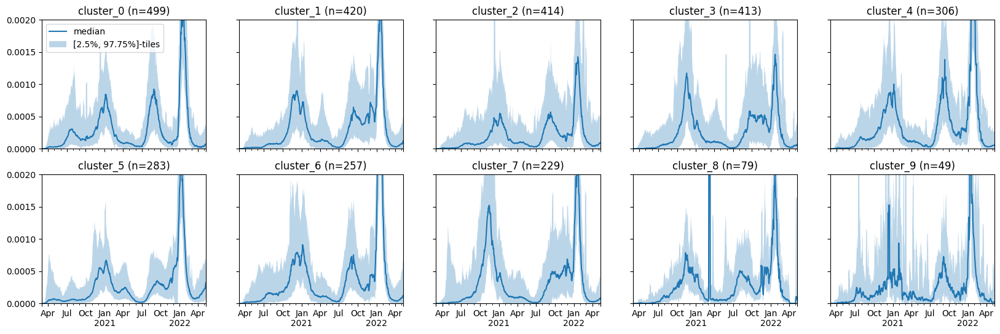

In [ ]:
def plot_cluster_medians(rate_df, label_df, nc=5, ylim=None):
  """Plots cluster medians with bounds of 2.5 and 97.5 percentiles.

  Args:
    rate_df: The dataframe containing incremental rates.
    label_df: The dataframe containing cluster labels of each county.
    nc: The number of columns in the output plot.
    ylim: The y-limits of the plots.

  Returns:
    A dataframe containing the median trends of the clusters. A group of trend
    plots with median trends with bounds of 2.5 and 97.5 percentiles is plotted.
  """
  n_cluster = label_df['Cluster'].nunique()
  nr = int(np.ceil(n_cluster / nc))
  fig, ax = plt.subplots(nr, nc, sharex=True, sharey=True, figsize=[20, 3*nr])
  ax = ax.flatten()
  all_trend = pd.DataFrame()
  if ylim is None:
    ylim = [0, rate_df.max().max()]
  for i, cluster in enumerate(sorted(label_df['Cluster'].unique())):
    temp_county = label_df[label_df['Cluster'] == cluster]['County'].values
    temp_rates = rate_df[temp_county]
    temp_stats = temp_rates.transpose().describe(percentiles=[0.025, 0.975])
    up_bound = temp_stats.loc['97.5%']
    low_bound = temp_stats.loc['2.5%']
    median_trend = temp_stats.loc['50%']
    all_trend[f'cluster_{i}'] = median_trend
    median_trend.plot(ax=ax[i], label='median')
    ax[i].set_title(f'cluster_{i} (n={len(temp_county)})')
    ax[i].fill_between(median_trend.index, low_bound.values, up_bound.values,
                       alpha=0.3, label='[2.5%, 97.75%]-tiles')
    ax[i].set_ylim(ylim)
    if i==0:
      ax[i].legend()
  return all_trend

median_case_trends = plot_cluster_medians(case_incremental_trends,
                                          case_cluster_labels, ylim=[0, 0.002])

## Geographical distribution of the clusters

Plot the heatmap of the distribution of the different trend patterns.

In [ ]:
def norm_by_range(x):
  """Normalizes an array by it's range.

  Args:
    x: an array or a pd.Series.

  Returns:
    A normalized array or pd.Series whose values are normalized to the range
    between 0 and 1.

  """
  return (x - x.min()) / (x.max() - x.min())

def show_values_on_map(values, title, adjust_cmap=False, **kwargs):
  """Shows the values associated with counties on a U.S. map.

  Args:
    values: A pd.Series containing the values of interest indexed by county geo
      IDs. The values can either be strings or numbers. Strings will be
      interpreted as groups and numbers will be used as continuous values.
    title: The title of the plot.
    adjust_cmap: Whether to adjust the color map. Only set this as True for
      numerical values. It will adjust the color scale so that the the plot is
      not influenced by severe outliers.
    **kwargs: Other key-value arguments passed to px.choropleth.

  Returns:
    A plotly.graph_objs._figure.Figure project.
  """
  plot_df = pd.DataFrame({
      'county': values.index,
      'value': values.values
  })
  plot_df['full_name'] = plot_df['county'].apply(get_name_by_geoid)
  plot_df['fips'] = plot_df['county'].apply(lambda x: x.split('/')[1])
  if adjust_cmap:
    value_describe = plot_df['value'].describe(
      percentiles=[0.01, 0.99])[['min','1%', '50%', '99%', 'max']]
    value_describe_norm = norm_by_range(value_describe)
    new_color_scale = [(0, 'green'),
                      (value_describe_norm['1%'], 'green'),
                      (value_describe_norm['50%'], 'white'),
                      (value_describe_norm['99%'], 'orange'),
                      (1, 'orange')]
    fig = px.choropleth(plot_df, locations='fips', geojson=COUNTIES_GEO,
                      color='value', scope="usa",
                      hover_data=['full_name'],
                      color_continuous_scale=new_color_scale,
                      title=title, **kwargs)
  else:
    fig = px.choropleth(plot_df, locations='fips', geojson=COUNTIES_GEO,
                      color='value', scope="usa",
                      hover_data=['full_name'],
                      title=title, **kwargs)
  return fig

str_cluster_labels = case_cluster_labels.sort_values(
    'Cluster').set_index('County')['Cluster'].apply(lambda x: f'cluster_{x}')
color_sequence = ['#2ca02c', '#ff7f0e', '#9467bd', '#8c564b', '#1f77b4',
                  '#d62728', '#17becf', '#bcbd22', '#7f7f7f','#e377c2']
show_values_on_map(str_cluster_labels, 'Case trend cluster distribution',
                         color_discrete_sequence = color_sequence)

# What features are potentially correlated with COVID-19 mortality rate?

Like the original analysis, in this section, we will explore the available context features and demonstrate two simple approaches (pairwise correlation / logistic regression) to discover features with potentially high correlation with the COVID-19 mortality rate.

Main steps in this analysis:
1. Context feature cleaning
2. Death ratio calculation
3. Pairwise correlation analysis
4. Logistic regression with PCA components

## Context feature cleaning

Like in the original analysis, we normalize / transform variables and impute missing values so that we can easily use them for the following analysis.

**Technical details**

* Given the purpose of our next step is to use these variables to better understand death-to-case ratio, most of the features with raw counts are not very helpful. We need to have normalized counts for the counties so that we can compare. Here we simply divide all the counts by a county's populations. A prefix 'Norm_' is added to such variables.
* The distribution of some features are highly skewed. We take a log transformation for these variables:
  * log transformation for Count_Person, LandAreaSqMeter, PopulationDensityPerSqMeter.
* Deal with missing values:
  * Features with > 40% missing values are dropped.
  * Missing values of each county are filled by the state median. If a value is missed for all counties in a state, they are filled by the median of all available states.

In [ ]:
features_updated = df_county_context.drop('Name', axis=1).copy()

# Normalized count variables by population.
# The variable names are updated to have prefix 'Norm_Count_'. The reason we
# don't use 'percent' here because some counts are not about 'person', for
# example, 'Count_Household_With3Person'. Normalized version of these features
# are not percentages. Although the new variables have the term 'count' in it,
# they are no longer 'counts', but actually 'ratios'.
count_feature_columns = [c for c in df_county_context if
                         c.startswith('Count_') and c != 'Count_Person']
population_col = df_county_context['Count_Person']
retaildrug_cols = [c for c in df_county_context if
                   c.startswith('RetailDrugDistribution_')]

# Refactored to avoid PerformanceWarnings
#for c in count_feature_columns + retaildrug_cols:
#  features_updated['Norm_' + c] = df_county_context[c] / population_col
new_columns = {}  # Dictionary to hold new columns
for c in count_feature_columns + retaildrug_cols:
    new_columns['Norm_' + c] = df_county_context[c] / population_col
features_updated = pd.concat([features_updated, pd.DataFrame(new_columns)], axis=1)

# The feature Percent_NoHealthInsurance_AmongUpto64Years is a little confusing:
# It's the percent of people up to 64 years without insurance among all people.
# We normalize it by percent of people up to 64 years.
features_updated['Percent_NoHealthInsurance_AmongUpto64Years'] = \
  features_updated['Percent_Person_Upto64Years_NoHealthInsurance'] / \
  (1 - features_updated['Norm_Count_Person_65OrMoreYears'])

# Take log for some features (population, area, retail drug distribution etc.)
features_updated['Log_Count_Person'] = np.log(df_county_context['Count_Person'])
features_updated['Log_LandAreaSqMeter'] = np.log(
    df_county_context['LandAreaSqMeter'])
features_updated['Log_PopulationDensityPerSqMeter'] = np.log(
    features_updated['PopulationDensityPerSqMeter'])

# Remove the raw count variables.
features_updated = features_updated.drop(
    count_feature_columns + retaildrug_cols + [
      'Count_Person', 'LandAreaSqMeter', 'PercentBlackOrAfricanAmericanAlone',
      'UnemploymentRate_Person', 'PopulationDensityPerSqMeter',
      'Percent_Person_Upto64Years_NoHealthInsurance'], axis=1)

# Remove columns with >40% missing values
col_missing_ratio = features_updated.apply(
  lambda x: sum(x.isna()) * 1. / len(x))
col_remove = col_missing_ratio[col_missing_ratio > 0.4].index.values
features_updated = features_updated.drop(col_remove, axis=1)

# Augment missing values
features_updated['State'] = features_updated['County'].apply(lambda x: x[:-3])
state_medians = features_updated.groupby('State').apply(lambda x: x.median(numeric_only=True)) # Refactored to avoid FutureWarning
state_medians = state_medians.apply(lambda x: np.where(x.isna(), x.median(), x))
for c in features_updated.columns:
  if c in ['County', 'State']:
    continue
  features_updated[c] = np.where(
      features_updated[c].isna(),
      state_medians.loc[features_updated['State']][c],
      features_updated[c]
  )

features_updated = features_updated.drop('State', axis=1).set_index('County')

## Death ratio calculation

Death ratios are calculated as the ratio between total death cases devided by total positive cases for each county.

Counties with total case counts < 10 are removed from this analysis.

Thankfully, death ratios came down considerably compared to those calculated in the original analysis in July 2020. This can be seen clearly in a comparison of the distributions of death ratios shown below the map.

In [ ]:
case_counts = df_county_joined[case_columns]
death_counts = df_county_joined[death_columns]

death_ratio = death_counts.max(axis=1) / case_counts.max(axis=1)
death_ratio = death_ratio[case_counts.max(axis=1) >= 10]
death_ratio = death_ratio[death_ratio < 1].dropna()
death_ratio = pd.DataFrame(death_ratio).reset_index()
death_ratio.columns = ['County', 'death_ratio']
death_ratio = death_ratio.set_index('County')

In [ ]:
show_values_on_map(death_ratio['death_ratio'], 'Death ratio distribution', True)

array([[<Axes: title={'center': 'death_ratio'}>]], dtype=object)

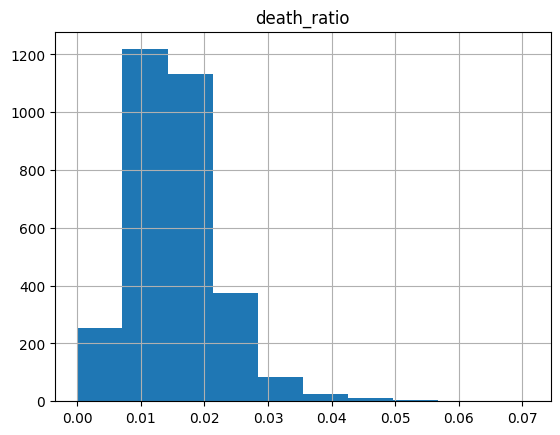

In [ ]:
# Distribution of death ratios calculated with updated data up to 2022-05-13
death_ratio.hist()

Death ratio calculated with original data up to 2020-07-10
* Note how righ-skewed this is with some horrifically high death ratios

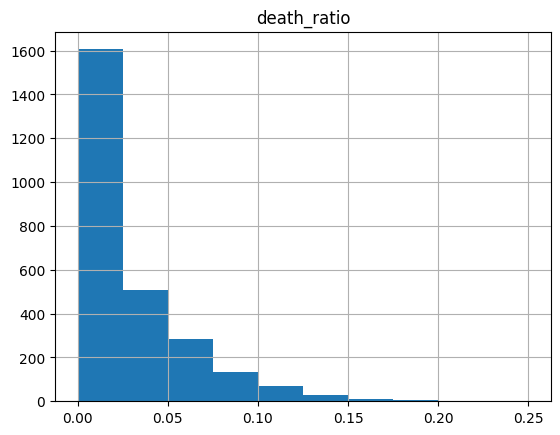

## Pairwise correlation analysis

Like the original analysis, I show the pairwise correlation among the context features and death ratio plotted in the heatmap below.

The top features with largest correlation with death ratio are listed below the heatmap.

Comparing the original top features correlated with the death ratio to those from the updated analysis reveals a shift in which factors are most strongly associated with COVID-19 mortality rates across counties.

**Original Analysis:**

* Factors related to demographics and socioeconomic status, such as population density, racial composition, household size, marital status, educational attainment, and certain types of employment, were most correlated with death ratios.
* There is a mix of both positive and negative correlations, but none are particularly strong (the highest absolute correlation is around 0.28).
* Some factors like higher educational attainment and never being married show a modest positive correlation with death ratios.

**Updated Analysis:**

* The updated features with the largest correlations with death ratios are more focused on housing, technology access, and socioeconomic factors such as median income and educational attainment.
* The negative correlations with median housing costs and median income might suggest that wealthier counties had lower death ratios, which could be due to better access to healthcare or the ability to work from home and socially distance effectively.
* There is a strong negative correlation with higher educational attainment, suggesting that areas with a higher proportion of people with bachelor's degrees or higher saw fewer deaths. This is in contrast to the original analysis, where educational attainment showed a positive correlation with death ratios.
* The presence of factors like no internet access and no computer in the updated analysis suggests that technology access, and by extension information and resources, could have played a significant role in the impact of COVID-19 in different areas.
* Factors such as the norm count of deaths in certain age groups indicate that older populations were more severely affected, which aligns with the known higher risk for severe outcomes from COVID-19 in older age groups.

Overall, the updated analysis suggests that economic factors and access to technology became more prominent in their association with COVID-19 death ratios as the pandemic progressed, possibly due to the longer-term socioeconomic impacts and the role of information dissemination in managing the pandemic. The shift from demographic factors to more economic and access-related factors could reflect the evolving nature of the pandemic and the varying responses across different communities.

<Axes: >

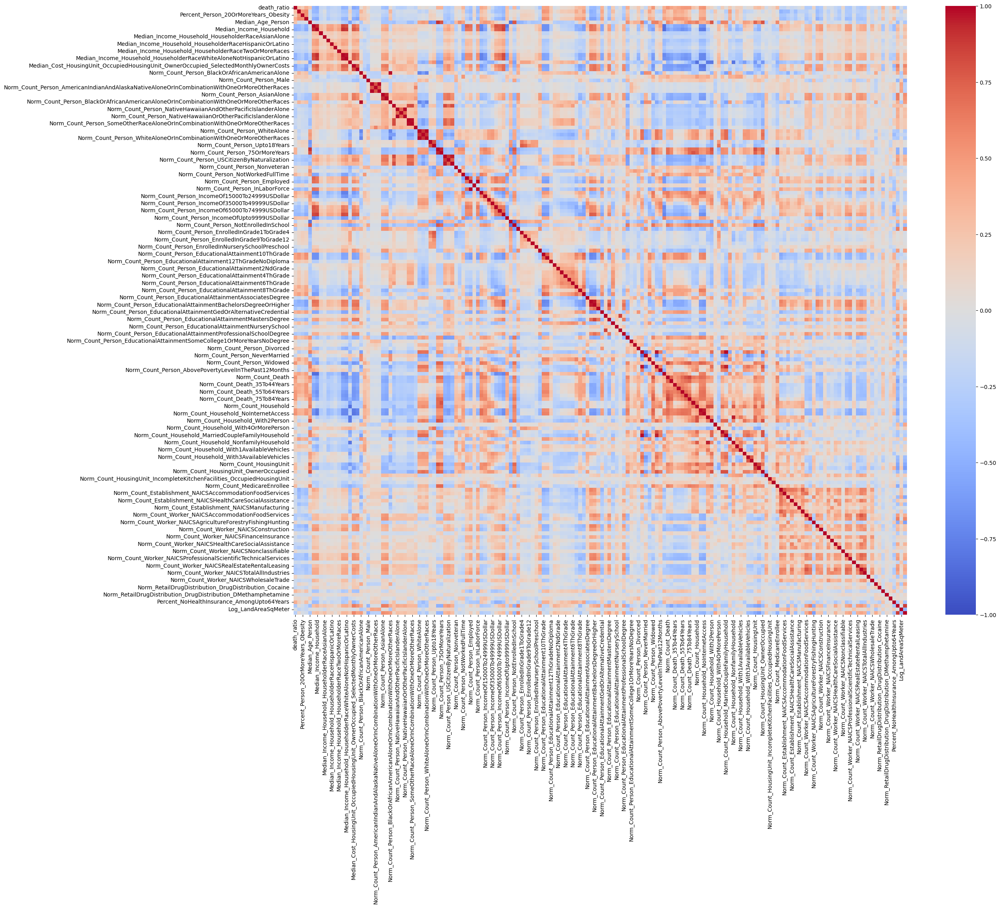

In [ ]:
df_death_ratio_joined = death_ratio.join(
    features_updated, how='inner'
)
corr_full = df_death_ratio_joined.corr('spearman')
fig, _ = plt.subplots(figsize=(25,20))
sns.heatmap(corr_full, cmap='coolwarm', vmin=-1, vmax=1)

In [ ]:
df_corr = corr_full[['death_ratio']].drop('death_ratio')
df_corr.columns = ['corr']
df_corr['abs_corr'] = abs(df_corr['corr'])

sorted_corr = df_corr.sort_values(['abs_corr'], ascending=False)
sorted_corr.head(20)

,corr,abs_corr
Median_Cost_HousingUnit_OccupiedHousingUnit_OwnerOccupied_SelectedMonthlyOwnerCosts,-0.532946,0.532946
Norm_Count_Household_NoInternetAccess,0.528072,0.528072
Norm_Count_Death,0.521938,0.521938
Norm_Count_Person_Widowed,0.514093,0.514093
Norm_Count_Household_NoComputer,0.503372,0.503372
Norm_Count_Death_65To74Years,0.502801,0.502801
Norm_Count_Death_75To84Years,0.499772,0.499772
Median_HomeValue_HousingUnit_OccupiedHousingUnit_OwnerOccupied,-0.497245,0.497245
Norm_Count_Death_55To64Years,0.495487,0.495487
Median_Income_Household,-0.494387,0.494387


### Deep dive for 'no internet'

We use a density plot to better understand the relationship between a context feature and the death ratio. Here we use no internet as an example to generate those plots.

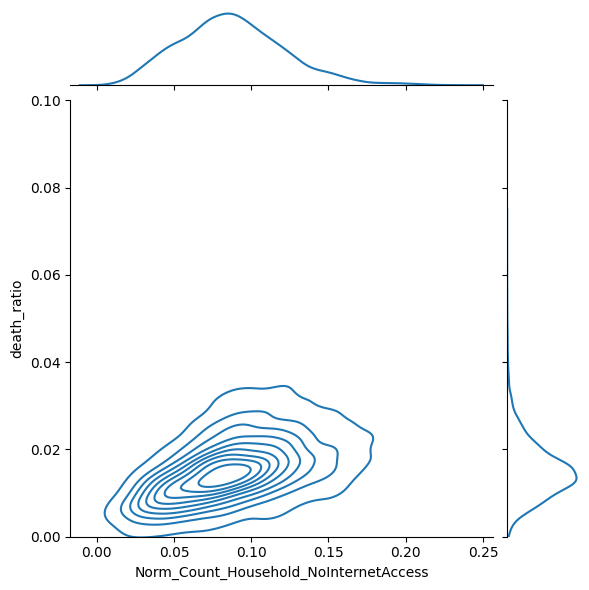

In [ ]:
sns.jointplot(data=df_death_ratio_joined,
              x='Norm_Count_Household_NoInternetAccess',
              y='death_ratio', kind='kde', ylim=[0, 0.1])

In [ ]:
show_values_on_map(features_updated['Norm_Count_Household_NoInternetAccess'],
                   'Norm_Count_Household_NoInternetAccess', True)

## Logistic regression with PCA

Here we demonstrate another approach to discover useful features by using a logistic regression with components generated from PCA (principle component analysis).

### Principle Component Analysis

The main purpose of PCA is to reduce the number of features by combining similar features. After this step, we will use 15 components generated from PCA instead of the set of ~165 features.

**Technical details**

We have lots of features (~165) in the data set. This could introduce misleading results for further analysis. For example, if we identify variables with significant effect with alpha=5%, we would expect about 8 'significant' features as false positive. In order to deal with it, we conduct a PCA to combine similar features.

All variables are normalized between [0, 1] before PCA. The explained variance vs number of principle components are plotted. We choose 15 components for further analysis as the curve starts to be flat after that.

In [ ]:
# Exclude columns with 'Norm_Count_Death', 'Log_Count_Person', 'Norm_Count_Household', 'Norm_Count_HousingUnit', 'Log_PopulationDensityPerSqMeter'
features_updated_select = features_updated[
    [col for col in features_updated.columns
     if 'Norm_Count_Death' not in col and 'Log_Count_Person' not in col and 'Norm_Count_Household' not in col and 'Norm_Count_HousingUnit' not in col and 'Log_PopulationDensityPerSqMeter' not in col]
]

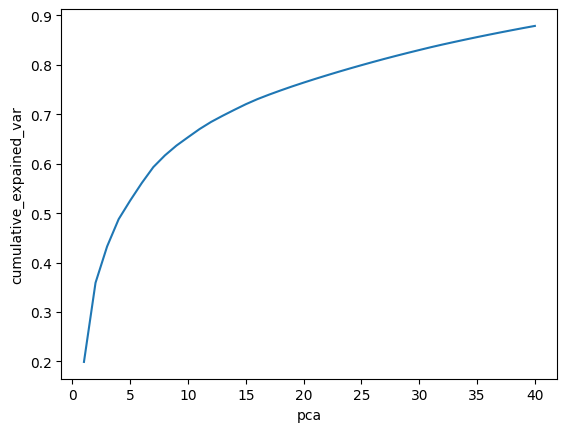

In [ ]:
#features_norm = features_updated.apply(norm_by_range)
features_norm = features_updated_select.apply(norm_by_range)

pca_full = PCA(n_components=40).fit(features_norm)
pca_var = pd.Series(pca_full.explained_variance_ratio_,
                    index=range(1, 41), name='explained_var')
ax = pca_var.cumsum().plot()
ax.set_xlabel('pca')
ax.set_ylabel('cumulative_expained_var')

pca_n = 15
pca = PCA(n_components=pca_n).fit(features_norm)
county_pcas = pd.DataFrame(features_norm.dot(pca.components_.transpose()))
county_pcas.columns = [f'pca_{i}' for i in range(1, pca_n+1)]

#### How to interpret a PCA component?

A PCA component can be understood as a weighted sum of a list of features. The meaning of the PCA is mainly decided by the few features with highest weights.

For example, the top features with most weights in first PCA component are shown below. You can also visualize it on the U.S. map to have a better understanding of its distribution.

In [ ]:
pca_weights = pd.DataFrame(pca.components_,
                           index=[f'pca_{i}' for i in range(1, pca_n+1)],
                           columns=features_norm.columns)

def get_top_features(compo_weights, top_n=50):
  """Gets top features for a component from its weight.

  Args:
    compo_weights: A series containing features weights of a component, indexed
      by the feature names.
    top_n: Show the top_n features of the component.

  Returns:
    A dataframe with three columns:
      rank: The rank of the feature in the list.
      top_feature: The name of the feature.
      weight: The weight of the feature.
  """
  abs_weights = abs(compo_weights)
  top_n_compos = abs_weights.sort_values(ascending=False).index.values[: top_n]
  return pd.DataFrame({
      'rank': range(1, top_n+1),
      'top_feature': top_n_compos,
      'weight': compo_weights[top_n_compos].values},
      index=range(1, top_n+1))

top_compos_df = pd.DataFrame(columns=['pca', 'rank', 'top_feature', 'weight'])
for i, row in pca_weights.iterrows():
    temp_top_compo = get_top_features(row)
    temp_top_compo['pca'] = i
    top_compos_df = pd.concat([top_compos_df, temp_top_compo]) # Used concat instead of append

top_compos_df = top_compos_df[['pca', 'rank', 'top_feature', 'weight']]


pca_of_interest = 'pca_1'
top_compos_df.query(f'pca=="{pca_of_interest}"')

,pca,rank,top_feature,weight
1,pca_1,1,Norm_Count_Person_EducationalAttainment10ThGrade,0.209857
2,pca_1,2,Norm_Count_Person_WhiteAloneNotHispanicOrLatino,-0.206590
3,pca_1,3,Norm_Count_Person_BelowPovertyLevelInThePast12Months,0.201222
4,pca_1,4,Median_Income_Household,-0.185145
5,pca_1,5,Norm_Count_Person_Employed,-0.173782
6,pca_1,6,Norm_Count_Person_BlackOrAfricanAmericanAloneOrInCombinationWithOneOrMoreOtherRaces,0.173256
7,pca_1,7,Norm_Count_Person_InLaborForce,-0.172369
8,pca_1,8,Norm_Count_Person_BlackOrAfricanAmericanAlone,0.170404
9,pca_1,9,Norm_Count_Person_EducationalAttainment9ThGrade,0.167855
10,pca_1,10,Median_Income_Person,-0.165450


In [ ]:
show_values_on_map(county_pcas['pca_1'], 'PCA_1 distrubtion', True)

### Logistic regression

We use a logistic model to find which PCA components are most correlated with death ratio. We rank the PCA components by their p-values. The smaller p-value indicates stronger relationship between the PCA components and the death ratio.

**Technical details**

The model is specified as:
$$logit(P(death|positive)) = \theta X,$$
where $X$ is the features of interest.

When training the model, each observation is a positive case associated with the corresponding county-level components, and the dependent variable is whether the patient died or not.



In this logistic regression model, we assess how various predictors influence the odds of 'death' relative to 'survival'. The model, built using a Generalized Linear Model (GLM) with a binomial family, predicts the log odds of death based on these predictors.

**Coefficients Interpretation:** \
* **Positive Coefficients:** Indicate an increase in the predictor's value raises the odds of death. These predictors are considered risk factors. \
* **Negative Coefficients:** Suggest an increase in the predictor's value decreases the odds of death, implying these are protective factors. \
* **Zero Coefficients:** Show no influence on the odds of death versus survival. \\

**Model Construction:** \
The response variable y is a two-column array capturing 'deaths' and 'survivals', allowing the model to estimate the log odds of a death outcome per observation.

**Limitations:** \
The pseudo-r2 of the original model is 1.0 which may indicate multicollinearity.  

The coefficients should provide insights into each predictor's effect on death odds, identifying significant risk and protective factors within the dataset.


In [ ]:
total_case_counts = df_county_joined[case_columns].max(axis=1)
total_death_counts = df_county_joined[death_columns].max(axis=1)

# recover binary data for logistic regression.
death_data = pd.DataFrame({'case': total_case_counts,
                           'death': total_death_counts},
             index=total_case_counts.index).dropna()
death_data = death_data[death_data['case'] >= 10]
death_data['survival'] = death_data['case'] - death_data['death']
death_data = death_data.drop('case', axis=1)
death_data = death_data.clip(lower=0)

def run_logistic_model(death_data, features=county_pcas):
  """Fits a logistic model to get feature coefficients.

  Args:
    death_data: A dataframe with two columns 'death' and 'survival', indexed by
      county geo IDs.
    features: A dataframe containing the features used for this analysis,
      indexed by county geo IDs.

  Returns:
    A list of two objects:
      * A data frame indexed by feature names, containing the corresponding
        p-value and coefficients.
      * The fitted model.
  """
  joined_data = features.join(death_data, how='inner')
  X = sm.add_constant(joined_data.drop(['death', 'survival'], axis=1))
  y = joined_data[['death', 'survival']].values

  observed_cases = joined_data['death'] + joined_data['survival']
  glm = sm.GLM(y, X, sm.families.Binomial())
  res = glm.fit()

  coefs = pd.DataFrame({
      'p-value': res.pvalues,
      'coef': res.params}, index=X.columns).sort_values('p-value')
  return coefs, res

logistic_coef, logistic_model = run_logistic_model(death_data, county_pcas)
logistic_model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:           ['y1', 'y2']   No. Observations:                 3099
Model:                            GLM   Df Residuals:                     3083
Model Family:                Binomial   Df Model:                           15
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -38955.
Date:                Sun, 04 Feb 2024   Deviance:                       57919.
Time:                        01:53:07   Pearson chi2:                 5.74e+04
No. Iterations:                     8   Pseudo R-squ. (CS):              1.000
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         -5.4540      0.018   -298.618      0.000      -5.490      -5.418
pca_1          0.4012      0.004    108.659      0.000       0.394       0.408
pca_2         -0.3580      0.003   -121.832      0.000      -0.364      -0.352
pca_3          0.0618      0.007      8.625      0.000       0.048       0.076
pca_4          0.1430      0.007     19.159      0.000       0.128       0.158
pca_5         -0.3571      0.008    -45.146      0.000      -0.373      -0.342
pca_6         -0.1304      0.009    -15.113      0.000      -0.147      -0.114
pca_7         -0.1348      0.008    -16.611      0.000      -0.151      -0.119
pca_8          0.0772      0.010      7.811      0.000       0.058       0.097
pca_9          0.3076      0.008     39.671      0.000       0.292       0.323
pca_10        -0.3416      0.009    -36.621      0.000      -0.360      -0.323
pca_11        -0.1076      0.009    -12.317      0.000      -0.125      -0.090
pca_12        -0.3157      0.010    -31.204      0.000      -0.336      -0.296
pca_13         0.1600      0.009     16.868      0.000       0.141       0.179
pca_14         0.5012      0.012     43.187      0.000       0.478       0.524
pca_15         0.0989      0.010      9.543      0.000       0.079       0.119
==============================================================================
"""

In [ ]:
# Function to create a table to compare logistic regression models

def add_model_metrics_to_table(logistic_model, model_name, comparison_table=None):
    """
    Adds the evaluation metrics of a logistic regression model to a comparison table.

    Args:
    logistic_model: The logistic regression model object after fitting.
    model_name: A string representing the name of the model for identification.
    comparison_table: A pandas DataFrame containing metrics of previously evaluated models.
                      If None, a new DataFrame will be created.

    Returns:
    A pandas DataFrame with the model's metrics added.
    """
    # Calculate McFadden's R-squared
    log_likelihood_fitted = logistic_model.llf
    log_likelihood_null = logistic_model.llnull
    mcFaddens_R2 = 1 - (log_likelihood_fitted / log_likelihood_null)

    # Extracting other relevant metrics
    log_likelihood = log_likelihood_fitted
    deviance = logistic_model.deviance
    pearson_chi2 = logistic_model.pearson_chi2
    #pseudo_R2 = logistic_model.prsquared  # Assuming this attribute is available

    # Construct the row to add
    metrics_row = {
        'Model Name': model_name,
        'Log-Likelihood': log_likelihood,
        'Deviance': deviance,
        'Pearson Chi-Squared': pearson_chi2,
        #'Pseudo R-squared (CS)': pseudo_R2,
        "McFadden's R-squared": mcFaddens_R2
    }

    # If comparison_table is None, initialize a new DataFrame
    if comparison_table is None:
        comparison_table = pd.DataFrame(columns=metrics_row.keys())

    # Append the new row
    comparison_table = comparison_table.append(metrics_row, ignore_index=True)

    return comparison_table

# Example usage
# Initialize an empty DataFrame for the first model
comparison_table = None

# Assuming 'logistic_model' is your fitted model object and 'model_name' is a descriptive name for your model
comparison_table = add_model_metrics_to_table(logistic_model, 'Original features', comparison_table)

# For subsequent models, pass the existing comparison_table
# comparison_table = add_model_metrics_to_table(logistic_model_cusp, 'CUSP PC', comparison_table)

comparison_table

<ipython-input-61-0af593d79e00>:42: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



,Model Name,Log-Likelihood,Deviance,Pearson Chi-Squared,McFadden's R-squared
0,Original features,-36847.50913,53702.856006,53436.482664,0.484778


PCA_14, _2, _9 and _15 have the largest absolute coefficients, indicating they explain a significant amount of variance in the death and survival rates.

Let's unpack their features:

In [ ]:
pca_of_interest = 'pca_14'
top_compos_df.query(f'pca=="{pca_of_interest}"')

,pca,rank,top_feature,weight
1,pca_14,1,Norm_Count_Household_With4OrMoreAvailableVehicles,-0.246455
2,pca_14,2,Norm_Count_Person_EducationalAttainmentSomeCollege1OrMoreYearsNoDegree,-0.245387
3,pca_14,3,Percent_NoHealthInsurance_AmongUpto64Years,0.235947


In [ ]:
pca_of_interest = 'pca_2'
top_compos_df.query(f'pca=="{pca_of_interest}"')

,pca,rank,top_feature,weight
1,pca_2,1,Norm_Count_Person_WhiteAloneNotHispanicOrLatino,-0.264921
2,pca_2,2,Norm_Count_Person_EducationalAttainmentRegularHighSchoolDiploma,-0.241076
3,pca_2,3,Norm_Count_Person_75OrMoreYears,-0.200248
4,pca_2,4,Norm_Count_Person_IncomeOf15000To24999USDollar,-0.184819
5,pca_2,5,Median_Age_Person,-0.180569
6,pca_2,6,Norm_Count_Person_HispanicOrLatino,0.179277
7,pca_2,7,Norm_Count_Person_WhiteAlone,-0.173742
8,pca_2,8,Norm_Count_Person_WhiteAloneOrInCombinationWithOneOrMoreOtherRaces,-0.170709
9,pca_2,9,Norm_Count_Person_Widowed,-0.159624
10,pca_2,10,Norm_Count_Person_65OrMoreYears,-0.159572


In [ ]:
pca_of_interest = 'pca_9'
top_compos_df.query(f'pca=="{pca_of_interest}"')

,pca,rank,top_feature,weight
1,pca_9,1,Median_Income_Household_HouseholderRaceAsianAlone,0.281140
2,pca_9,2,Norm_Count_Person_AmericanIndianAndAlaskaNativeAloneOrInCombinationWithOneOrMoreOtherRaces,0.276844
3,pca_9,3,Norm_Count_Person_AmericanIndianOrAlaskaNativeAlone,0.258557


In [ ]:
pca_of_interest = 'pca_15'
top_compos_df.query(f'pca=="{pca_of_interest}"')

,pca,rank,top_feature,weight
1,pca_15,1,Percent_NoHealthInsurance_AmongUpto64Years,0.274470
2,pca_15,2,Norm_RetailDrugDistribution_DrugDistribution_Amphetamine,0.269350
3,pca_15,3,Norm_Count_Person_EducationalAttainmentSomeCollegeLessThan1Year,-0.237636


In [ ]:
county_pcas.columns

Index(['pca_1', 'pca_2', 'pca_3', 'pca_4', 'pca_5', 'pca_6', 'pca_7', 'pca_8',
       'pca_9', 'pca_10', 'pca_11', 'pca_12', 'pca_13', 'pca_14', 'pca_15'],
      dtype='object')

In [ ]:
# Select PCAs
county_pcas_select = county_pcas[['pca_1']]

In [ ]:
# Logistic regression with selected PCs
logistic_coef_select, logistic_model_select = run_logistic_model(death_data, county_pcas_select)
logistic_model_select.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:           ['y1', 'y2']   No. Observations:                 3099
Model:                            GLM   Df Residuals:                     3097
Model Family:                Binomial   Df Model:                            1
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -57424.
Date:                Sun, 04 Feb 2024   Deviance:                       94855.
Time:                        02:19:17   Pearson chi2:                 9.79e+04
No. Iterations:                     8   Pseudo R-squ. (CS):             0.9999
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         -4.0279      0.002  -1690.856      0.000      -4.033      -4.023
pca_1          0.4059      0.002    168.620      0.000       0.401       0.411
==============================================================================
"""

In [ ]:
# Update model comparison_table
comparison_table = add_model_metrics_to_table(logistic_model_select, 'Features PCA_1', comparison_table)
comparison_table

<ipython-input-61-0af593d79e00>:42: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



,Model Name,Log-Likelihood,Deviance,Pearson Chi-Squared,McFadden's R-squared
0,Original features,-3.684751e+04,5.370286e+04,5.343648e+04,0.484778
1,CUSP PC,-5.655263e+06,9.412271e+06,1.010298e+07,0.146613
2,Merged PC,-2.604873e+06,3.311490e+06,3.322833e+06,0.606921
3,CUSP select,-2.653852e+06,3.409447e+06,3.427820e+06,0.599530
4,Features select,-6.659201e+04,1.131919e+05,1.181715e+05,0.068874
5,Features PCA_1,-5.742354e+04,9.485491e+04,9.788328e+04,0.197073


# CUSP analysis

This is where the original analysis ended, so let's check in on our original questions:

1. How do the COVID-19 case trends differ across different counties?

By clustering counties, we identified discernible geographic patterns in COVID-19 case trends.

2. What features are potentially correlated with COVID-19 mortality rate?

Through correlation analysis and logistic regression, we explored how demographic, economic, and social factors correlate with COVID-19 mortality rates, illustrated by a heatmap and modeled outcomes.

\

Finally, we can get to our new question:

3. Did the states' different policy responses have a significant impact on county case and mortality rates?

Below we aim to assess the effect of varied state policy responses on county case and mortality rates. This will involve correlation analysis and logistic regression using CUSP variables, followed by a comprehensive regression model that combines original and CUSP variables to evaluate the significance of policy differences after accounting for known factors.

## Pairwise correlation analysis

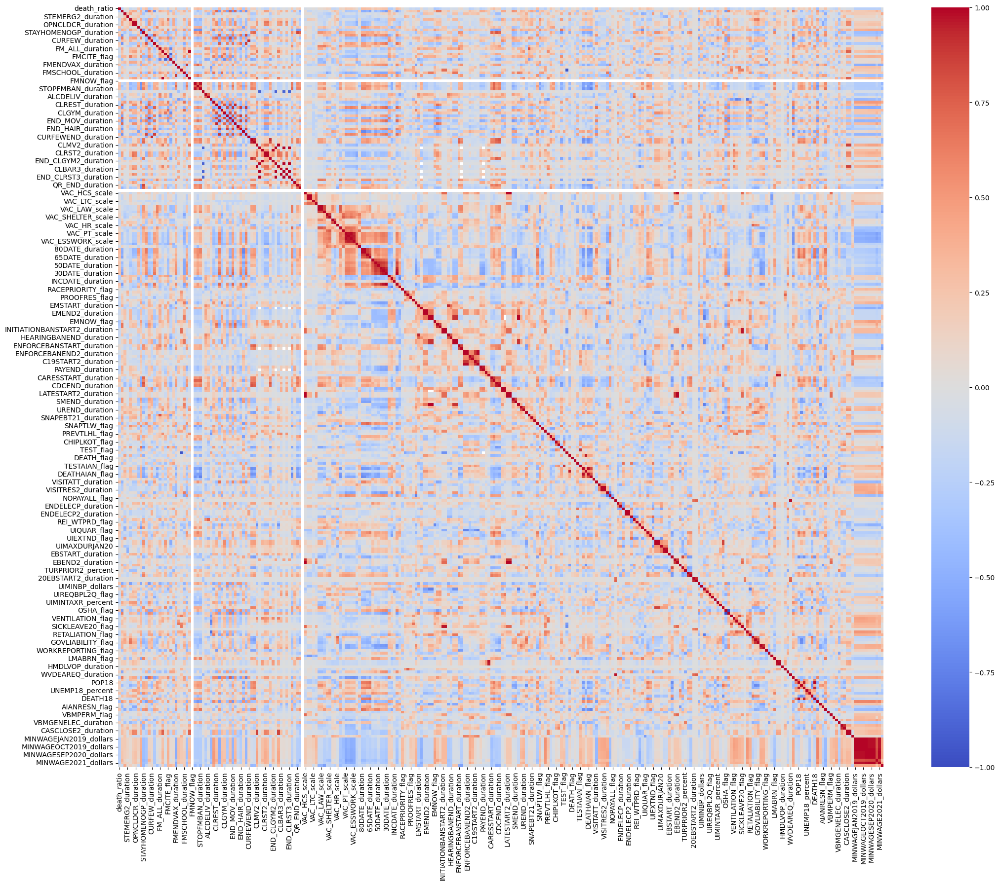

In [ ]:
def create_or_load_corr_heatmap(death_ratio, cusp_variables, model_path=None):
    """Generates or loads a correlation heatmap.

    Args:
      death_ratio: A dataframe containing death ratio data.
      cusp_variables: A dataframe containing CUSP variables.
      model_path: Path to a pickled correlation matrix. If provided, the function
                  will load the matrix from this path instead of computing a new one.

    Returns:
      The correlation matrix and the heatmap figure.
    """
    if model_path:
        # Load the correlation matrix from a pickle file
        death_ratio_2 = death_ratio.reset_index()
        death_ratio_2['state_id'] = death_ratio_2['County'].str[:-3]
        death_ratio_cusp = death_ratio_2.merge(cusp_variables, left_on='state_id', right_on='STATE_ID', how='inner')
        death_ratio_cusp.drop('state_id', axis=1, inplace=True)
        with open(model_path, 'rb') as file:
            corr_full_cusp = pickle.load(file)
    else:
        # Compute the correlation matrix
        death_ratio_2 = death_ratio.reset_index()
        death_ratio_2['state_id'] = death_ratio_2['County'].str[:-3]
        death_ratio_cusp = death_ratio_2.merge(cusp_variables, left_on='state_id', right_on='STATE_ID', how='inner')
        death_ratio_cusp.drop('state_id', axis=1, inplace=True)
        corr_full_cusp = death_ratio_cusp.corr('spearman')

    # Draw the heatmap
    fig, ax = plt.subplots(figsize=(25, 20))
    sns.heatmap(corr_full_cusp, cmap='coolwarm', vmin=-1, vmax=1, ax=ax)
    return death_ratio_cusp, corr_full_cusp, fig

# Usage
# To compute a new correlation matrix and draw heatmap
# corr_full_cusp, heatmap_cusp = create_or_load_corr_heatmap(death_ratio, cusp_variables)

# To load a correlation matrix from a pickle file and draw heatmap
death_ratio_cusp, corr_full_cusp, heatmap_cusp = create_or_load_corr_heatmap(death_ratio, cusp_variables, model_path='/content/corr_full_cusp.pkl')


In [ ]:
# Pickle the correlation matrix
with open('/content/corr_full_cusp.pkl', 'wb') as file:
    pickle.dump(corr_full_cusp, file)
files.download('/content/corr_full_cusp.pkl')

In [ ]:
# Strongest correlations
df_corr_cusp = corr_full_cusp[['death_ratio']].drop('death_ratio')
df_corr_cusp.columns = ['corr']
df_corr_cusp['abs_corr'] = abs(df_corr_cusp['corr'])

sorted_corr_cusp = df_corr_cusp.sort_values(['abs_corr'], ascending=False)
sorted_corr_cusp.head(20)

,corr,abs_corr
MH19,-0.396187,0.396187
END_MOV_duration,0.362258,0.362258
ENDREST_duration,0.349566,0.349566
EMNOW_flag,-0.332921,0.332921
FMLOCALBAN_duration,0.325946,0.325946
END_RELG_duration,-0.324404,0.324404
END_HAIR_duration,0.316247,0.316247
80DATE_duration,0.311471,0.311471
SNAPSUSP_duration,0.308747,0.308747
75DATE_duration,0.307349,0.307349


 **Positive correlations** \
END_MOV_duration - Reopened movie theaters \
END_REST_duration - Reopen restaurants \
FMLOCALBAN_duration - Banned other local face mask mandates \
END_HAIR_duration - Reopened hair salons/barber shops \
80DATE_duration - Date adults ages 80+ became eligible for COVID-19 vaccination \
SNAPSUSP_duration - SNAP Waiver - Temporary Suspension of Claims Collection \
75DATE_duration - Date adults ages 75+ became eligible for COVID-19 vaccination \
ENDRETL_duration - Reopened other non-essential retail \
END_STHM_duration - End/relax stay at home/shelter in place \
VISITATT_duration - Stopped legal visitation in state prisons \
CARESEND_duration - CARES Act pleading end \
OSHA_flag - OSHA-approved state plan \


**Negative correlations** \
MH19 - Mental health professionals per 100,000 population in 2019 \
EMNOW_flag - Eviction moratorium currently in place \
END_RELG_duration - Reopened religious gatherings \
STATEDEPT_flag - State department in charge of enforcing programs \
INITIATIONBANSTART_duration - First eviction initiation ban start \
MEDEXP_flag - Medicaid Expansion \
GROCERYDATE_duration - Date grocery store workers became eligible for COVID-19 vaccination \
CLBSNS_duration - Closed other non-essential businesses \

**Interpretation** \
Variables ending in *_duration* are calculated from the date of the policy action until the end of the analysis period e.g. END_MOV (date when movie theatres reopened) until 2022-05-13.

A positive correlation with death_ratio implies that a longer duration of this policy action is observed in counties with a higher death ratio.

A negative correlation implies that a longer duration of this policy action is observed in counties with a lower death ratio.

## Logistic regression with PCA


### Principle Component Analysis

The main purpose of PCA is to reduce the number of features by combining similar features. After this step, we will use 20 components generated from PCA instead of the set of ~280 CUSP features.

**Technical details**

We have lots of features in the data set. This could introduce misleading results for further analysis.

All variables are normalized between [0, 1] before PCA. The explained variance vs number of principle components are plotted. We choose 20 components for further analysis as the curve starts to be flat after that.

In [ ]:
# Exclude 'STATE' and 'STATE_ID' columns from PCA
columns_for_pca = [col for col in death_ratio_cusp.columns if col not in ['STATE', 'STATE_ID','death_ratio']]
cusp_pca_data = death_ratio_cusp[columns_for_pca]

In [ ]:
# Find the number of NaNs in each column
nan_counts = cusp_pca_data.isna().sum()

# Print columns with their NaN counts
print(nan_counts[nan_counts > 0])

EMEND_duration             1024
ENFORCEBANEND_duration     1024
PAYEND_duration            4558
CARESEND_duration         28185
CDCEND_duration            2809
LATEEND_duration          17689
UIMINBP_dollars            1521
dtype: int64


Thankfully none of these columns with NaN values were among those most highly correlated with the death_ratio so we will drop them and continue with the PCA.

[Extension: check death_ratio correlation of these variables]

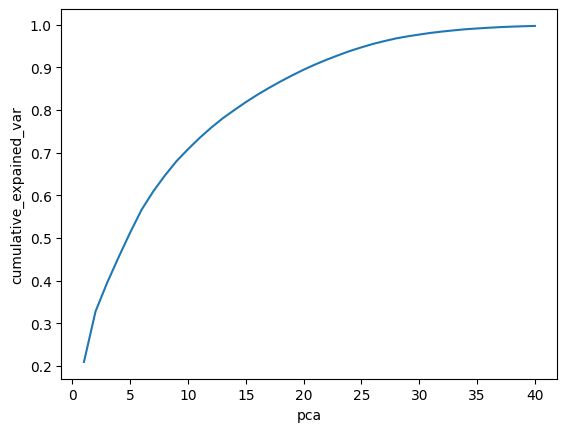

In [ ]:
# Drop columns with any NaN values
cusp_pca_data = cusp_pca_data.dropna(axis=1)

# Set 'County' column as the index of the DataFrame
cusp_pca_data = cusp_pca_data.set_index('County')

# PCA
features_norm = cusp_pca_data
pca_full = PCA(n_components=40).fit(features_norm)
pca_var = pd.Series(pca_full.explained_variance_ratio_,
                    index=range(1, 41), name='explained_var')
ax = pca_var.cumsum().plot()
ax.set_xlabel('pca')
ax.set_ylabel('cumulative_expained_var')

pca_n = 20
pca = PCA(n_components=pca_n).fit(features_norm)
county_pcas_cusp = pd.DataFrame(features_norm.dot(pca.components_.transpose()))
county_pcas_cusp.columns = [f'pca_{i}' for i in range(1, pca_n+1)]

In [ ]:
pca_weights = pd.DataFrame(pca.components_,
                           index=[f'pca_{i}' for i in range(1, pca_n+1)],
                           columns=features_norm.columns)

top_compos_cusp = pd.DataFrame(columns=['pca', 'rank', 'top_feature', 'weight'])
for i, row in pca_weights.iterrows():
    temp_top_compo = get_top_features(row)
    temp_top_compo['pca'] = i
    top_compos_cusp = pd.concat([top_compos_cusp, temp_top_compo]) # Used concat instead of append

top_compos_cusp = top_compos_cusp[['pca', 'rank', 'top_feature', 'weight']]


pca_of_interest = 'pca_8'
top_compos_cusp.query(f'pca=="{pca_of_interest}"')

,pca,rank,top_feature,weight
1,pca_8,1,Median_Income_Household_HouseholderRaceAsianAlone,0.236027
2,pca_8,2,Norm_Count_Person_Employed,-0.224181
3,pca_8,3,Norm_Count_Person_InLaborForce,-0.210004
4,pca_8,4,Norm_Count_Person_NotAUSCitizen,-0.189869
5,pca_8,5,Percent_NoHealthInsurance_AmongUpto64Years,-0.189346
6,pca_8,6,Median_Age_Person,0.184729
7,pca_8,7,Norm_Count_Person_AmericanIndianAndAlaskaNativeAloneOrInCombinationWithOneOrMoreOtherRaces,0.168483
8,pca_8,8,Norm_Count_Person_AmericanIndianOrAlaskaNativeAlone,0.161773
9,pca_8,9,Norm_Count_Person_AmericanIndianAndAlaskaNativeAlone,0.161773
10,pca_8,10,Norm_Count_Person_GraduateOrProfessionalSchool,-0.160936


### Logistic regression

We use a logistic model to find which PCA components are most correlated with death ratio. We rank the PCA components by their p-values. The smaller p-value indicates stronger relationship between the PCA components and the death ratio.

**Technical details**

The model is specified as:
$$logit(P(death|positive)) = \theta X,$$
where $X$ is the features of interest.

When training the model, each observation is a positive case associated with the corresponding county-level components, and the dependent variable is whether the patient died or not.

In [ ]:
# Logistic regression with CUSP PCA variables
logistic_coef_cusp, logistic_model_cusp = run_logistic_model(death_data, county_pcas_cusp)
logistic_model_cusp.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:           ['y1', 'y2']   No. Observations:               295142
Model:                            GLM   Df Residuals:                   295121
Model Family:                Binomial   Df Model:                           20
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:            -5.6553e+06
Date:                Sun, 04 Feb 2024   Deviance:                   9.4123e+06
Time:                        02:02:27   Pearson chi2:                 1.01e+07
No. Iterations:                    30   Pseudo R-squ. (CS):             0.9986
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         -4.5905      0.001  -4305.401      0.000      -4.593      -4.588
pca_1          0.0227   4.64e-05    489.252      0.000       0.023       0.023
pca_2          0.0267    7.7e-05    346.924      0.000       0.027       0.027
pca_3          0.0131      0.000    129.234      0.000       0.013       0.013
pca_4          0.0044      0.000     38.878      0.000       0.004       0.005
pca_5         -0.0528      0.000   -509.458      0.000      -0.053      -0.053
pca_6         -0.0578      0.000   -433.001      0.000      -0.058      -0.058
pca_7         -0.0031      0.000    -23.959      0.000      -0.003      -0.003
pca_8          0.0768      0.000    535.404      0.000       0.077       0.077
pca_9         -0.0253      0.000   -187.470      0.000      -0.026      -0.025
pca_10        -0.0304      0.000   -177.149      0.000      -0.031      -0.030
pca_11         0.0387      0.000    261.035      0.000       0.038       0.039
pca_12        -0.0524      0.000   -326.660      0.000      -0.053      -0.052
pca_13         0.0381      0.000    230.674      0.000       0.038       0.038
pca_14        -0.0325      0.000   -155.653      0.000      -0.033      -0.032
pca_15         0.0110      0.000     67.684      0.000       0.011       0.011
pca_16        -0.0239      0.000   -108.228      0.000      -0.024      -0.023
pca_17        -0.0230      0.000   -109.318      0.000      -0.023      -0.023
pca_18         0.0174      0.000     93.695      0.000       0.017       0.018
pca_19        -0.0394      0.000   -180.450      0.000      -0.040      -0.039
pca_20         0.0112      0.000     62.092      0.000       0.011       0.012
==============================================================================
"""

In [ ]:
# Update model comparison_table
comparison_table = add_model_metrics_to_table(logistic_model_cusp, 'CUSP PC', comparison_table)
comparison_table

<ipython-input-61-0af593d79e00>:42: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



,Model Name,Log-Likelihood,Deviance,Pearson Chi-Squared,McFadden's R-squared
0,Original features,-3.684751e+04,5.370286e+04,5.343648e+04,0.484778
1,CUSP PC,-5.655263e+06,9.412271e+06,1.010298e+07,0.146613


### Logit with both PCAs (original features and CUSP)

In [ ]:
# Merge PCAs into one dataframe
county_pcas_cusp_with_suffix = county_pcas_cusp.add_suffix('_cusp')
county_pcas_merged = pd.merge(county_pcas_cusp_with_suffix, county_pcas, left_index=True, right_index=True, how='inner')

In [ ]:
# Logistic regression
logistic_coef_merged, logistic_model_merged = run_logistic_model(death_data, county_pcas_merged)
logistic_model_merged.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:           ['y1', 'y2']   No. Observations:               295142
Model:                            GLM   Df Residuals:                   295106
Model Family:                Binomial   Df Model:                           35
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:            -2.6049e+06
Date:                Sun, 04 Feb 2024   Deviance:                   3.3115e+06
Time:                        02:03:01   Pearson chi2:                 3.32e+06
No. Iterations:                     9   Pseudo R-squ. (CS):              1.000
Covariance Type:            nonrobust                                         
===============================================================================
                  coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------
const          -5.3226      0.002  -2287.533      0.000      -5.327      -5.318
pca_1_cusp      0.0021      0.000     18.943      0.000       0.002       0.002
pca_2_cusp      0.0227   9.26e-05    244.955      0.000       0.022       0.023
pca_3_cusp      0.0067      0.000     62.009      0.000       0.007       0.007
pca_4_cusp      0.0396      0.000    278.372      0.000       0.039       0.040
pca_5_cusp     -0.0309      0.000   -267.970      0.000      -0.031      -0.031
pca_6_cusp     -0.0279      0.000   -189.119      0.000      -0.028      -0.028
pca_7_cusp     -0.0208      0.000   -141.615      0.000      -0.021      -0.020
pca_8_cusp      0.0306      0.000    177.381      0.000       0.030       0.031
pca_9_cusp      0.0064      0.000     41.722      0.000       0.006       0.007
pca_10_cusp    -0.0050      0.000    -25.922      0.000      -0.005      -0.005
pca_11_cusp    -0.0254      0.000   -155.987      0.000      -0.026      -0.025
pca_12_cusp    -0.0538      0.000   -308.615      0.000      -0.054      -0.053
pca_13_cusp     0.0303      0.000    173.440      0.000       0.030       0.031
pca_14_cusp    -0.0311      0.000   -129.778      0.000      -0.032      -0.031
pca_15_cusp     0.0119      0.000     66.173      0.000       0.012       0.012
pca_16_cusp     0.0035      0.000     14.681      0.000       0.003       0.004
pca_17_cusp    -0.0358      0.000   -161.956      0.000      -0.036      -0.035
pca_18_cusp     0.0176      0.000     86.658      0.000       0.017       0.018
pca_19_cusp     0.0038      0.000     16.382      0.000       0.003       0.004
pca_20_cusp    -0.0094      0.000    -44.934      0.000      -0.010      -0.009
pca_1          -0.1368      0.000   -324.664      0.000      -0.138      -0.136
pca_2          -0.4876      0.000  -1519.415      0.000      -0.488      -0.487
pca_3          -0.0894      0.001   -173.605      0.000      -0.090      -0.088
pca_4           0.1067      0.001    117.421      0.000       0.105       0.108
pca_5           0.1503      0.001    143.044      0.000       0.148       0.152
pca_6          -0.0502      0.001    -47.827      0.000      -0.052      -0.048
pca_7          -0.2634      0.001   -274.228      0.000      -0.265      -0.262
pca_8          -0.2985      0.001   -264.379      0.000      -0.301      -0.296
pca_9           0.3015      0.001    243.483      0.000       0.299       0.304
pca_10         -0.1195      0.001   -149.100      0.000      -0.121      -0.118
pca_11         -0.0901      0.001    -82.129      0.000      -0.092      -0.088
pca_12          0.0072      0.001      6.514      0.000       0.005       0.009
pca_13          0.1124      0.001     84.556      0.000       0.110       0.115
pca_14          0.6294      0.001    440.732      0.000       0.627       0.632
pca_15         -0.4343      0.001   -326.58

In [ ]:
# Update model comparison_table
comparison_table = add_model_metrics_to_table(logistic_model_merged, 'Merged PC', comparison_table)
comparison_table

<ipython-input-61-0af593d79e00>:42: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



,Model Name,Log-Likelihood,Deviance,Pearson Chi-Squared,McFadden's R-squared
0,Original features,-3.684751e+04,5.370286e+04,5.343648e+04,0.484778
1,CUSP PC,-5.655263e+06,9.412271e+06,1.010298e+07,0.146613
2,Merged PC,-2.604873e+06,3.311490e+06,3.322833e+06,0.606921


In [ ]:
pca_of_interest = 'pca_17'
top_compos_cusp.query(f'pca=="{pca_of_interest}"')

,pca,rank,top_feature,weight
1,pca_17,1,WORKERTYPE_flag,0.314970
2,pca_17,2,FMLOCALBAN_duration,0.170540
3,pca_17,3,AGEPRIORITY_flag,0.158314


pca_4_cusp \
SNAPSUSP_duration: SNAP Waiver - Temporary Suspension of Claims Collection \
VISITATT_duration: Stopped legal visitation in state prisons \
HOSPAIAN_flag: Report Indigenous COVID-19 hospitalizations \

pca_8_cusp \
GOVLIABILITY_flag: Branch of government implementing COVID-19 liability rules \
STAYHOME_duration: Stay at home/ shelter in place \
CASCLOSE_duration: Closed casinos \

pca_12_cusp \
VBMAUTOAP_flag: Automatic applications sent for mail-in ballots in response to COVID-19 \
SNAPSUSP_duration: SNAP Waiver - Temporary Suspension of Claims Collection \
WORKREPORTING_flag: Data reporting required for medical treatment \

pca_17_cusp \
WORKERTYPE_flag: Types of workers eligible for workers' compensation expansion \
FMLOCALBAN_duration: Banned other local face mask mandates \
AGEPRIORITY_flag: Adults ages 65+ prioritized ahead of essential workers \


pca_13_cusp \
EMNOW_flag: Eviction moratorium currently in place \
FMCITE_flag: Face mask mandate enforced by criminal charge/citation \
REI_WKSR_flag: Reinstated work search requirement for UI



In [ ]:
# Unpack the individual CUSP variables that showed the greatest influence
cusp_select = cusp_pca_data[['SNAPSUSP_duration','VISITATT_duration','HOSPAIAN_flag','GOVLIABILITY_flag','STAYHOME_duration','CASCLOSE_duration','VBMAUTOAP_flag','WORKREPORTING_flag','WORKERTYPE_flag','FMLOCALBAN_duration','AGEPRIORITY_flag','EMNOW_flag','FMCITE_flag','REI_WKSR_flag']]

# Merge selected CUSP variables with original feature PCA
county_pcas_cusp_select = pd.merge(cusp_select, county_pcas, left_index=True, right_index=True, how='inner')

In [ ]:
# Logit with selected CUSP variables
logistic_coef_cusp_select, logistic_model_cusp_select = run_logistic_model(death_data, county_pcas_cusp_select)
logistic_model_cusp_select.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:           ['y1', 'y2']   No. Observations:               295142
Model:                            GLM   Df Residuals:                   295112
Model Family:                Binomial   Df Model:                           29
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:            -2.6539e+06
Date:                Sun, 04 Feb 2024   Deviance:                   3.4094e+06
Time:                        02:03:18   Pearson chi2:                 3.43e+06
No. Iterations:                     8   Pseudo R-squ. (CS):              1.000
Covariance Type:            nonrobust                                         
=======================================================================================
                          coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                  -5.5982      0.002  -2382.996      0.000      -5.603      -5.594
SNAPSUSP_duration       0.1606      0.001    289.219      0.000       0.160       0.162
VISITATT_duration       0.1214      0.000    349.545      0.000       0.121       0.122
HOSPAIAN_flag           0.0383      0.000     80.003      0.000       0.037       0.039
GOVLIABILITY_flag       0.0095      0.000     28.587      0.000       0.009       0.010
STAYHOME_duration       0.1144      0.001    157.756      0.000       0.113       0.116
CASCLOSE_duration       0.1306      0.000    284.280      0.000       0.130       0.132
VBMAUTOAP_flag         -0.0210      0.000    -56.797      0.000      -0.022      -0.020
WORKREPORTING_flag     -0.0056      0.000    -16.333      0.000      -0.006      -0.005
WORKERTYPE_flag         0.0292      0.000     90.818      0.000       0.029       0.030
FMLOCALBAN_duration     0.0254      0.001     39.138      0.000       0.024       0.027
AGEPRIORITY_flag        0.0133      0.000     29.271      0.000       0.012       0.014
EMNOW_flag             -0.0790      0.000   -185.155      0.000      -0.080      -0.078
FMCITE_flag            -0.0920      0.000   -200.547      0.000      -0.093      -0.091
REI_WKSR_flag           0.0068      0.000     14.437      0.000       0.006       0.008
pca_1                  -0.1465      0.000   -363.518      0.000      -0.147      -0.146
pca_2                  -0.4760      0.000  -1606.872      0.000      -0.477      -0.475
pca_3                  -0.0733      0.000   -154.055      0.000      -0.074      -0.072
pca_4                   0.1089      0.001    123.429      0.000       0.107       0.111
pca_5                   0.1118      0.001    118.849      0.000       0.110       0.114
pca_6                  -0.1145      0.001   -120.032      0.000      -0.116      -0.113
pca_7                  -0.1877      0.001   -217.752      0.000      -0.189      -0.186
pca_8                  -0.2943      0.001   -276.425      0.000      -0.296      -0.292
pca_9                   0.3617      0.001    310.717      0.000       0.359       0.364
pca_10                 -0.0826      0.001   -109.259      0.000      -0.084      -0.081
pca_11                 -0.0318      0.001    -31.051      0.000      -0.034      -0.030
pca_12                  0.0237      0.001     21.702      0.000       0.022       0.026
pca_13                  0.1024      0.001     82.575      0.000       0.100       0.105
pca_14                  0.6239      0.001    478.180      0.000       0.621       0.626
pca_15                 -0.5234      0.001   -420.886      0.000      -0.526      -0.521
=======================================================================================
"""

In [ ]:
# Update model comparison_table
comparison_table = add_model_metrics_to_table(logistic_model_cusp_select, 'CUSP select', comparison_table)
comparison_table

<ipython-input-61-0af593d79e00>:42: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



,Model Name,Log-Likelihood,Deviance,Pearson Chi-Squared,McFadden's R-squared
0,Original features,-3.684751e+04,5.370286e+04,5.343648e+04,0.484778
1,CUSP PC,-5.655263e+06,9.412271e+06,1.010298e+07,0.146613
2,Merged PC,-2.604873e+06,3.311490e+06,3.322833e+06,0.606921
3,CUSP select,-2.653852e+06,3.409447e+06,3.427820e+06,0.599530



The SNAP Waiver for Temporary Suspension of Claims Collection refers to a policy decision made during the COVID-19 pandemic by various states in the United States to temporarily halt the collection of overpayment claims against beneficiaries of the Supplemental Nutrition Assistance Program (SNAP). Typically, when SNAP benefits are overissued—either due to administrative errors, misunderstanding by the beneficiary, or other reasons—the state agency is responsible for collecting the overpaid amount. These collections can involve reducing future benefit amounts or taking legal action to recover the funds.

However, during the COVID-19 pandemic, recognizing the increased financial strain on individuals and families, and the challenges of administering programs while adhering to public health guidelines, the U.S. Department of Agriculture (USDA), which oversees SNAP, granted states the option to request waivers that would temporarily suspend these collection activities. This suspension aimed to provide immediate relief to individuals who might already be facing heightened economic instability due to the pandemic. It was part of broader efforts to ease administrative requirements and enhance access to essential food assistance during a time of increased need.

This waiver meant that for a specified period, states would not actively pursue collection of overpaid SNAP benefits, allowing recipients to retain more of their benefits and reduce their financial stress. The intention was not to forgive these overpayments but to delay collection efforts until the waiver period ended, acknowledging the extraordinary circumstances caused by the pandemic.

States that opted to implement this waiver submitted requests to the USDA, detailing how they intended to manage the temporary suspension and ensure compliance with federal guidelines. The flexibility provided by these waivers was critical in helping states adapt their SNAP operations to the challenges posed by COVID-19, ensuring that the program could continue to serve as a vital safety net for young people and families in need during the crisis.

# Next steps:
- Interpret significant CUSP variables
- SNAP: how much was it worth in $. Where?
- Map select cusp variables

- Investigate Pseudo R-squ. (CS):	1.000 for cusp select logit
  - Features PCA 1 and 2
  - Played around with removing features (population, deaths,...) but still haven't found the problem variables
  - Checked original model, also has a pseudo of 1.0
  - Systematically remove variables until pseudo < 1.0?

- Shorten intro
- Add more interpretation and insights
- Consider another model

# Appendix

## Load live data set

You can directly query Data Commons for the latest COVID-19 and covariate data. Note that most covariate sources are not updated as frequently as COVID-19 sources.

In [ ]:
!pip install datacommons_pandas
import datacommons_pandas as dc

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.8/45.8 kB 522.7 kB/s eta 0:00:00


In [ ]:
# COVID-19 cases and deaths for state and county.
# DCID updated from original that appears to be discontinued: 'CumulativeCount_MedicalTest_ConditionCOVID_19_Positive' → ‘CumulativeCount_MedicalConditionIncident_COVID_19_ConfirmedCase’

df_state_positive = dc.build_time_series_dataframe(df_state_context['State'], 'CumulativeCount_MedicalConditionIncident_COVID_19_ConfirmedOrProbableCase', desc_col=True)
df_state_deaths = dc.build_time_series_dataframe(df_state_context['State'], 'CumulativeCount_MedicalConditionIncident_COVID_19_PatientDeceased', desc_col=True)

df_county_positive = dc.build_time_series_dataframe(df_county_context['County'], 'CumulativeCount_MedicalConditionIncident_COVID_19_ConfirmedOrProbableCase', desc_col=True)
df_county_deaths = dc.build_time_series_dataframe(df_county_context['County'], 'CumulativeCount_MedicalConditionIncident_COVID_19_PatientDeceased', desc_col=True)

df_county_deaths.head()

ValueError: Response error: An HTTP 502 code was returned by the REST API. Printing response

b'\n<html><head>\n<meta http-equiv="content-type" content="text/html;charset=utf-8">\n<title>502 Server Error</title>\n</head>\n<body text=#000000 bgcolor=#ffffff>\n<h1>Error: Server Error</h1>\n<h2>The server encountered a temporary error and could not complete your request.<p>Please try again in 30 seconds.</h2>\n<h2></h2>\n</body></html>\n'

In [ ]:
# State covariates
df_state = dc.build_multivariate_dataframe(df_state_context['State'], df_state_context.columns[:])
df_state.head()

,Count_Person_Separated,Count_Person_BelowPovertyLevelInThePast12Months,Count_Household_FamilyHousehold,Median_HomeValue_HousingUnit_OccupiedHousingUnit_OwnerOccupied,Count_Worker_NAICSHealthCareSocialAssistance,Count_Person_Upto5Years,Count_Person_InLaborForce,Count_Person_IncomeOf15000To24999USDollar,Count_Person_IncomeOf35000To49999USDollar,Count_Person_EducationalAttainment11ThGrade,...,Count_Household,Median_Income_Household_HouseholderRaceNativeHawaiianOrOtherPacificIslanderAlone,Count_Person_HispanicOrLatino,Count_Person_EnrolledInSchool,Count_Person_EducationalAttainment10ThGrade,Count_Household_With1Person,Count_Person_WorkedFullTime,Count_Household_With4OrMoreAvailableVehicles,RetailDrugDistribution_DrugDistribution_AnabolicSteroids,RetailDrugDistribution_DrugDistribution_Heroin
place,,,,,,,,,,,,,,,,,,,,,
geoId/01,87373.946,769819,1227508,157100,278618,295632,2.242701e+06,582784,480721,88988,...,1867893,55787,2.096788e+05,1175774,84786,574809,919811,171334,NaN,NaN
geoId/02,9889.784,75016,166325,282800,50185,50791,3.921732e+05,61951,70354,6937,...,253346,69557,5.159476e+04,183894,5832,69569,143410,21073,NaN,NaN
geoId/04,96798.493,934911,1679198,265600,422823,412606,3.343750e+06,718325,763018,84043,...,2571268,78141,2.206744e+06,1765901,63281,728964,1345150,193885,NaN,NaN
geoId/05,55546.288,468113,765440,142100,203648,184580,1.379728e+06,364436,302524,49307,...,1158071,50977,2.249528e+05,733114,40357,334220,545556,83740,NaN,NaN
geoId/06,635765.600,4741175,8958436,573200,2659229,2350335,1.992833e+07,3522460,3345027,415111,...,13044266,87066,1.532056e+07,10423307,306069,3137231,7724745,1296483,NaN,NaN


In [ ]:
# County covariates (this query takes a while: ~3000 counties for 200 variables)
df_county = dc.build_multivariate_dataframe(df_county_context['County'], df_county_context.columns[2:])
df_county.head()

,Count_Person_WhiteAloneOrInCombinationWithOneOrMoreOtherRaces,Count_Person_Veteran,Count_Household_FamilyHousehold,Count_HousingUnit_IncompleteKitchenFacilities_OccupiedHousingUnit,Median_HomeValue_HousingUnit_OccupiedHousingUnit_OwnerOccupied,Count_Person_IncomeOf35000To49999USDollar,Count_Person_EducationalAttainment11ThGrade,Count_Person_MarriedAndNotSeparated,Count_Death_35To44Years,Count_Worker_NAICSArtsEntertainmentRecreation,...,Median_Income_Household_HouseholderRaceTwoOrMoreRaces,Count_Worker_NAICSRealEstateRentalLeasing,Median_Income_Household_HouseholderRaceAmericanIndianOrAlaskaNativeAlone,Count_Death_DiseasesOfBloodAndBloodFormingOrgansAndImmuneDisorders,Median_Income_Household_HouseholderRaceNativeHawaiianOrOtherPacificIslanderAlone,Count_Death_5To14Years,Count_Death_1To4Years,Count_Worker_NAICSNonclassifiable,RetailDrugDistribution_DrugDistribution_AnabolicSteroids,RetailDrugDistribution_DrugDistribution_Heroin
place,,,,,,,,,,,,,,,,,,,,,
geoId/01001,43516.0,4960.0,15076.0,148.0,164900.0,5568.0,767.0,23789.304,18.0,329.0,...,73214.0,143.0,107656.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
geoId/01003,204713.0,19888.0,53467.0,587.0,226600.0,23063.0,2516.0,103014.409,53.0,1795.0,...,68500.0,2062.0,44266.0,13.0,NaN,NaN,NaN,NaN,NaN,NaN
geoId/01005,12329.0,1445.0,6187.0,52.0,89500.0,1872.0,1024.0,7718.004,10.0,43.0,...,20972.0,49.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
geoId/01007,17233.0,1143.0,4789.0,110.0,102900.0,1685.0,670.0,8195.856,12.0,9.0,...,20966.0,26.0,20724.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
geoId/01009,56172.0,3219.0,14874.0,181.0,138100.0,5787.0,1166.0,26252.395,27.0,48.0,...,48636.0,36.0,65385.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## Decide cluster number in trend analysis

We will use a k-means algorithm to cluster the counties by their incremental case trends.

The first step is to decide the proper number of clusters. In order to do that, we utilize within-cluster sum of squares and Silhouette average.

Looking at the graphs:
* The WCSS doesn't provide a clear answer. There is no distinct elbow in the plot, and the WCSS just gradually levels off.
* The 1-step differential plot suggests that after around 10 clusters, additional clusters do not significantly improve the WCSS.
* The silhouette score plot suggests that 6 or possibly 10 clusters might be good choices, with 6 having a slightly higher score. The Silhouette score being the most direct measure of cluster quality (because it takes into account both cohesion and separation), we might lean towards 6 clusters as the optimal number.

However, since there's no distinct peak and given the ambiguity in the other plots, it might be beneficial to consider the specific use case, the interpretability of the clusters, and possibly to review the clusters qualitatively for 6 and 10 clusters before making a final decision.

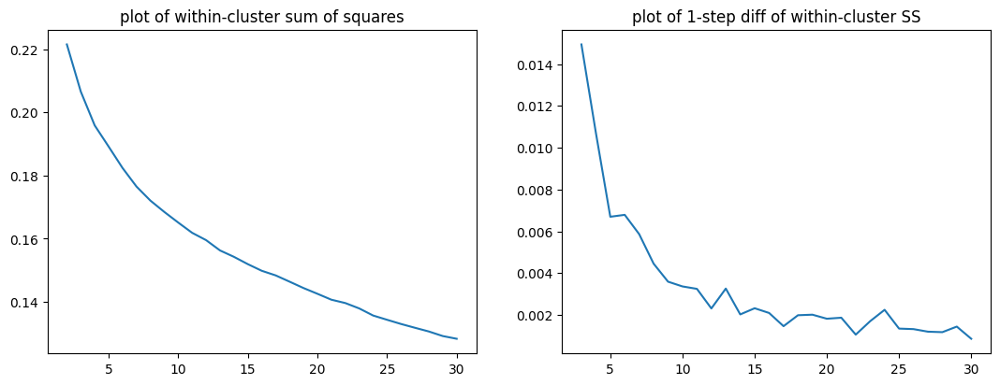

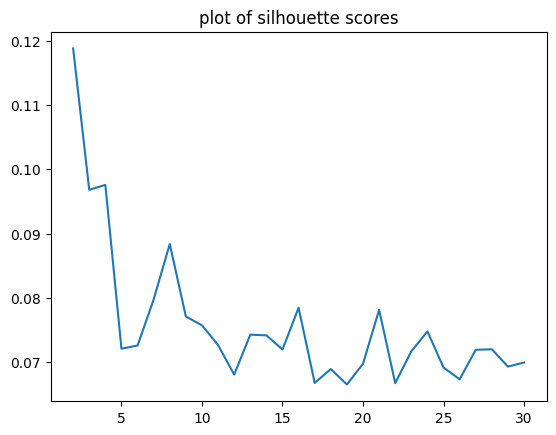

In [ ]:
def find_proper_n_cluster(incremental_trend_df, max_clusters=30,
                          min_clusters=2, random_seed=42, **kmeans_kwargs):
  """Finds the proper number of K-Means clusters.

     This functions doesn't automatically find the best number of clusters, but
     only shows plots of within-cluster sum of squares and Silhuette averages to
     help decide the cluster number.

  Args:
    incremental_trend_df: A dataframe containing incremental trends generated
      from the function 'obtain_incremental_trend'.
    max_clusters: The maximal number of clusters we want to check.
    min_clusters: The minimal number of clusters we want to check.
    random_seed: A random seed to fix the k-means algorithm results.
    **kmeans_kw: Named arguments passed to the KMeans fucntion at each step.

  Returns:
    Two dataframes are returned. They contain within-cluster sum of squares and
    Silhouette averages at each choice of cluster number respectively.
  """
  np.random.seed(random_seed)
  cluster_data_df = incremental_trend_df.transpose()
  ss = []
  silhouette_avgs = []
  num_cluster_choices = range(min_clusters, max_clusters + 1)
  for nc in num_cluster_choices:
    temp_km = KMeans(n_clusters=nc,
                     random_state=np.random.randint(0, 1e5),
                     **kmeans_kwargs).fit(cluster_data_df)
    temp_ss = temp_km.inertia_
    temp_labels = temp_km.predict(cluster_data_df)
    temp_sa = silhouette_score(cluster_data_df, temp_labels)
    ss.append(temp_ss)
    silhouette_avgs.append(temp_sa)
  ss = pd.Series(ss, index=num_cluster_choices)
  silhouette_avgs = pd.Series(silhouette_avgs, index=num_cluster_choices)
  fig, ax = plt.subplots(ncols=2, figsize=(13, 4.5))
  ax = ax.flatten()
  ss.plot(title='plot of within-cluster sum of squares', ax=ax[0])
  (-ss.diff()).plot(title='plot of 1-step diff of within-cluster SS', ax=ax[1])
  fig = plt.figure()
  silhouette_avgs.plot(title='plot of silhouette scores')
  return ss, silhouette_avgs

ss, sa = find_proper_n_cluster(case_incremental_trends, n_init=50)

## What if we specify more clusters in the trend clustering analysis?

You may wonder what happens if we specify more than 9 clusters in the trend cluster analysis. We try to answer that question here.

By looking at the plot about '1-step diff of within-cluster SS' (<a href='#scrollTo=Il3SwBemPca3'>here</a>), we see that there is a relatively steep drop between step 14 and step 15. Hence we choose 14 as the number of clusters for our analysis in this part.

The trends of the clusters are shown below.

* The patterns of the largest three clusters are bascially the same as they in the 9-cluster result.
* The main difference between the two versions is that 'cluster_0' has 400 less counties in this 14-cluster result. Some of these counties are contributing to exsiting clusters, like cluster_1 or cluster_2, and some others are forming up new clusters.
* Some clusters in the 14-cluster result share similar patterns, for example cluster_1 and cluster_3 are both counties with increasing trends, while cluster_3 is slightly more severe.
* The 14-cluster result has more small groups containing less than 5 counties.

Based on these observations, the 9-cluster result is preferred as it is granular enough and easy to interpret.

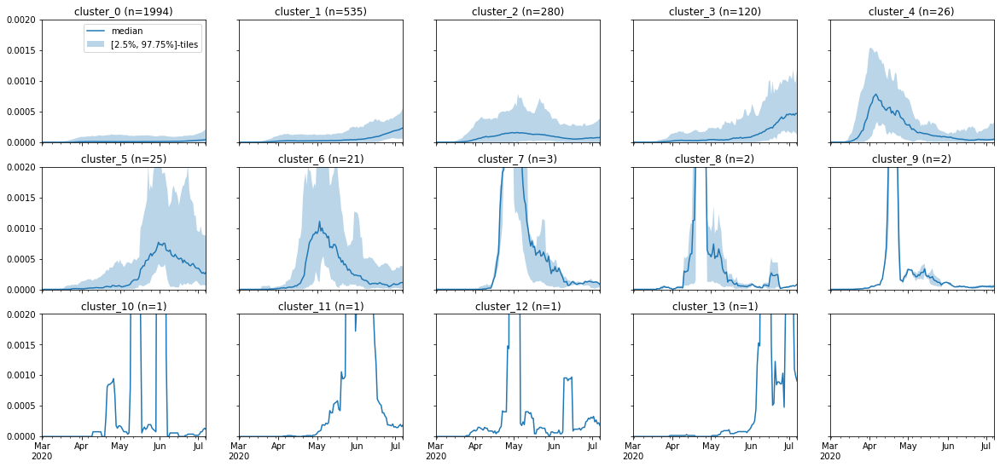

In [ ]:
case_cluster_labels_detailed = get_cluster_labels(case_incremental_trends, 14,
                                         random_state=42, n_init=1000)
median_case_trends = plot_cluster_medians(case_incremental_trends,
                                          case_cluster_labels_detailed,
                                          ylim=[0,0.002])

# OLD DATA

In [ ]:
# OLD DATA
# The Google files are in this Google Drive Folder:
# https://drive.google.com/drive/u/1/folders/1mM1scQxsD38tlSk7IcSKJrN7Ez5-J22F

analysis_data_start = datetime.strptime('2020-02-26', '%Y-%m-%d')
analysis_data_end = datetime.strptime('2020-07-10', '%Y-%m-%d')
date_range =  pd.date_range(analysis_data_start, analysis_data_end).format(
    formatter=lambda x: x.strftime('%Y-%m-%d'))
count_data_columns = ['County', 'Name'] + date_range

STATE_COVARIATE_PATH = 'https://docs.google.com/spreadsheets/d/e/2PACX-1vR12v_MRKdDa6u2mdD0aPFlDilV0SJtbeYyrNbqI3qZDuImw_RnDcpNAmwbJkRP7O7fAC-9EYsoV4Dm/pub?output=csv'
df_state_context = pd.read_csv(STATE_COVARIATE_PATH)
COUNTY_COVARIATE_PATH = 'https://docs.google.com/spreadsheets/d/e/2PACX-1vSSeYEVT9wH-F6X7qxnhyXke1JoudkpqAJqVdZWlkTLF0Ah5529VDB4gLLICrqpczbvl-qi_P7Eyte7/pub?output=csv'
df_county_context = pd.read_csv(COUNTY_COVARIATE_PATH)

COUNTY_POSITIVE_COUNT_PATH = 'https://docs.google.com/spreadsheets/d/e/2PACX-1vSv2PsEqsv4wyVUG9F3SCBMgMm9vXQg05a_Hyjc7xw5uOmlNUFYSg75JxvRQ3yuHodoZMFcK_FB1J3H/pub?output=csv'
df_county_case = pd.read_csv(COUNTY_POSITIVE_COUNT_PATH)
df_county_case = df_county_case[count_data_columns]

COUNTY_DEATH_COUNT_PATH = 'https://docs.google.com/spreadsheets/d/e/2PACX-1vRqhlJ7yAGMEJtnS8-8BISwB7ZfB9WyHFtOpbGe5v_hVmUHXvkXyJCXCDX-jp8u6KC-SdbVBs4c78aI/pub?output=csv'
df_county_death = pd.read_csv(COUNTY_DEATH_COUNT_PATH)
df_county_death = df_county_death[count_data_columns]